# Analysis
In this notebook various figures are made. It contains the following major parts:
- Lowest resolution labels (Harmonize labels and umaps)
- Proportion (Barplots)
- Markers (umaps)
- Sankey (sankey plots)
- Neuron (Pieplots and umap)
- Oligodendrocyte (umap)
- Astrocyte (umap)

In [1]:
import sys
print(sys.executable)
print(sys.version)
print(sys.version_info)

/home/hers_basak/jjiang/jack/miniconda/envs/scarches2/bin/python
3.9.18 (main, Sep 11 2023, 13:41:44) 
[GCC 11.2.0]
sys.version_info(major=3, minor=9, micro=18, releaselevel='final', serial=0)


In [2]:
from IPython.display import display, HTML
display(HTML("<style>.container { width:90% !important; }</style>"))#embed HTML within IPython notebook and make containers 90% of screen
import numpy as np
import pandas as pd
import anndata as ad
import scanpy as sc
import seaborn as sns
import os
import matplotlib.pyplot as plt
#import scvi
import torch

%matplotlib inline
sc.settings.verbosity = 0             # verbosity: errors (0), warnings (1), info (2), hints (3)
sc.settings.set_figure_params(dpi=80, facecolor='white') #figure resolution and background color

#To make reproducible plots
np.random.seed(41)
# This is used
# os.path.join('data/'+object_names[i][6:10]+'_preprocessed.h5ad')
#sc.logging.print_versions()

In [3]:
sc.settings.figdir = '/home/hers_basak/jjiang/jack/outputs/deliverables/6_analysis/'

Functions for sankey plot

In [66]:
import collections
import colorsys
import seaborn as sns
import matplotlib.pyplot
import matplotlib.path
import matplotlib.patches

import matplotlib
matplotlib.rcParams['pdf.fonttype'] = 42

def get_distinct_colors(n):
    # Use colorblind colorpalette
    x = sns.color_palette('colorblind', n_colors=n)
    return x

def text_width(fig, ax, text, fontsize):
    text = ax.text(-100, 0, text, fontsize=fontsize)
    text_bb = text.get_window_extent(renderer=fig.canvas.get_renderer())
    text_bb = text_bb.transformed(fig.dpi_scale_trans.inverted())
    width = text_bb.width
    text.remove()
    return width


class Sankey:
    def __init__(self, x, y,
                 plot_width=8,
                 plot_height=8,
                 gap=0.3,
                 alpha=0.35,
                 fontsize='small',
                 left_order=None,
                 mapping=None,
                 tag=None,
                 title=None,
                 title_left=None,
                 title_right=None,
                 ax=None
    ):
        self.X = x
        self.Y = y
        if ax:
            self.plot_width = ax.get_position().width * ax.figure.get_size_inches()[0]
            self.plot_height = ax.get_position().height * ax.figure.get_size_inches()[1]
        else:
            self.plot_width = plot_width
            self.plot_height = plot_height
        self.gap = gap
        self.alpha = alpha
        self.fontsize = fontsize
        self.tag = tag
        self.map = mapping is not None
        self.mapping = mapping
        self.mapping_colors = {
            'increase': '#1f721c',
            'decrease': '#ddc90f',
            'mistake': '#dd1616',
            'correct': '#dddddd',
            'novel': '#59a8d6',
        }
        self.title = title
        self.title_left = title_left
        self.title_right = title_right

        self.need_title = any(map(lambda x: x is not None, (title, title_left, title_right)))
        if self.need_title:
            self.plot_height -= 0.5

        self.init_figure(ax)

        self.flows = collections.Counter(zip(x, y))
        self.init_nodes(left_order)

        self.init_widths()
        # inches per 1 item in x and y
        self.resolution = (plot_height - gap * (len(self.left_nodes) - 1)) / len(x)
        self.colors = {
            name: colour
            for name, colour
            in zip(self.left_nodes.keys(),
                   get_distinct_colors(len(self.left_nodes)))
        }

        self.init_offsets()

    def init_figure(self, ax):
        self.fig = matplotlib.pyplot.figure()
        self.ax = matplotlib.pyplot.Axes(self.fig, [0, 0, 1, 1])
        self.fig.add_axes(self.ax)
#         self.fig = ax.figure
#         self.ax = ax

    def init_nodes(self, left_order):
        left_nodes = {}
        right_nodes = {}
        left_offset = 0
        for (left, right), flow in self.flows.items():
            if left in left_nodes:
                left_nodes[left] += flow
            else:
                left_nodes[left] = flow
            if right in right_nodes:
                node = right_nodes[right]
                node[0] += flow
                if flow > node[2]:
                    node[1] = left
                    node[2] = flow
            else:
                right_nodes[right] = [flow, left, flow]

        self.left_nodes = collections.OrderedDict()
        self.left_nodes_idx = {}
        if left_order is None:
            key = lambda pair: -pair[1]
        else:
            left_order = list(left_order)
            key = lambda pair: left_order.index(pair[0])

        for name, flow in sorted(left_nodes.items(), key=key):
            self.left_nodes[name] = flow
            self.left_nodes_idx[name] = len(self.left_nodes_idx)

        left_names = list(self.left_nodes.keys())
        self.right_nodes = collections.OrderedDict()
        self.right_nodes_idx = {}
        for name, node in sorted(
            right_nodes.items(),
            key=lambda pair: (left_names.index(pair[1][1]), -pair[1][2])
        ):
            self.right_nodes[name] = node[0]
            self.right_nodes_idx[name] = len(self.right_nodes_idx)

    def init_widths(self):
        self.left_width = max(
            (text_width(self.fig,
                        self.ax,
                        node,
                        self.fontsize) for node in self.left_nodes)
        )
        if self.title_left:
            self.left_width = max(
                self.left_width,
                text_width(self.fig, self.ax, self.title_left, self.fontsize) / 2
            )
        self.right_width = max(
            (text_width(self.fig,
                        self.ax,
                        node,
                        self.fontsize) for node in self.right_nodes)
        )
        if self.title_right:
            self.right_width = max(
                self.right_width,
                text_width(self.fig, self.ax, self.title_right, self.fontsize) / 2
            )

        self.right_stop = self.plot_width - self.left_width - self.right_width
        self.middle1_stop = self.right_stop * 9 / 20
        self.middle2_stop = self.right_stop * 11 / 20

    def init_offsets(self):
        self.offsets_l = {}
        self.offsets_r = {}

        offset = 0
        for name, flow in self.left_nodes.items():
            self.offsets_l[name] = offset
            offset += flow * self.resolution + self.gap

        offset = 0
        for name, flow in self.right_nodes.items():
            self.offsets_r[name] = offset
            offset += flow * self.resolution + self.gap

    def draw_flow(self, left, right, flow, node_offsets_l, node_offsets_r):
        P = matplotlib.path.Path

        flow *= self.resolution
        left_y = self.offsets_l[left] + node_offsets_l[left]
        right_y = self.offsets_r[right] + node_offsets_r[right]
        if self.need_title:
            left_y += 0.5
            right_y += 0.5
        node_offsets_l[left] += flow
        node_offsets_r[right] += flow
        color = self.colors[left]
        if self.mapping is not None:
            color = self.mapping_colors[self.mapping.category(left, right)]

        path_data = [
            (P.MOVETO, (0, -left_y)),
            (P.LINETO, (0, -left_y - flow)),
            (P.CURVE4, (self.middle1_stop, -left_y - flow)),
            (P.CURVE4, (self.middle2_stop, -right_y - flow)),
            (P.CURVE4, (self.right_stop, -right_y - flow)),
            (P.LINETO, (self.right_stop, -right_y)),
            (P.CURVE4, (self.middle2_stop, -right_y)),
            (P.CURVE4, (self.middle1_stop, -left_y)),
            (P.CURVE4, (0, -left_y)),
            (P.CLOSEPOLY, (0, -left_y)),
        ]
        codes, verts = zip(*path_data)
        path = P(verts, codes)
        patch = matplotlib.patches.PathPatch(
            path,
            facecolor=color,
            alpha=0.9 if flow < .02 else self.alpha,
            edgecolor='none',
        )
        self.ax.add_patch(patch)

    def draw_label(self, label, is_left):
        nodes = self.left_nodes if is_left else self.right_nodes
        offsets = self.offsets_l if is_left else self.offsets_r
        y = offsets[label] + nodes[label] * self.resolution / 2
        if self.need_title:
            y += 0.5

        self.ax.text(
            -.1 if is_left else self.right_stop + .1,
            -y,
            label,
            horizontalalignment='right' if is_left else 'left',
            verticalalignment='center',
            fontsize=self.fontsize,
        )

    def draw_titles(self):
        if self.title:
            self.ax.text(
                self.right_stop / 2,
                -0.25,
                self.title,
                horizontalalignment="center",
                verticalalignment="center",
                fontsize=self.fontsize,
                fontweight="bold"
            )
        if self.title_left:
            self.ax.text(
                -.1,
                -0.25,
                self.title_left,
                horizontalalignment="right",
                verticalalignment="center",
                fontsize=self.fontsize
            )
        if self.title_right:
            self.ax.text(
                self.right_stop + .1,
                -0.25,
                self.title_right,
                horizontalalignment="left",
                verticalalignment="center",
                fontsize=self.fontsize
            )

    def draw(self, save, name_file):
        node_offsets_l = collections.Counter()
        node_offsets_r = collections.Counter()

        for (left, right), flow in sorted(
            self.flows.items(),
            key=lambda pair: (self.left_nodes_idx[pair[0][0]],
                              self.right_nodes_idx[pair[0][1]])
        ):
            self.draw_flow(left, right, flow, node_offsets_l, node_offsets_r)

        for name in self.left_nodes:
            self.draw_label(name, True)
        for name in self.right_nodes:
            self.draw_label(name, False)
        self.draw_titles()

        self.ax.axis('equal')
        self.ax.set_xlim(-self.left_width - self.gap,
                         self.right_stop + self.gap + self.right_width)
        self.ax.get_xaxis().set_visible(False)
        self.ax.get_yaxis().set_visible(False)
        for k in self.ax.spines.keys():
            self.ax.spines[k].set_visible(False)
        # matplotlib.pyplot.axis('off')
        # self.fig.set_figheight(self.plot_height)
        # self.fig.set_figwidth(self.plot_width)
        if self.tag:
            text_ax = self.fig.add_axes((0.02, 0.95, 0.05, 0.05), frame_on=False)
            text_ax.set_axis_off()
            matplotlib.pyplot.text(0, 0, self.tag, fontsize=30, transform=text_ax.transAxes)
        if save:
            matplotlib.pyplot.savefig(name_file + '.png', bbox_inches='tight')
        #matplotlib.pyplot.tight_layout()


def sankey(x, y, save=False, name_file='sankey', **kwargs):
    diag = Sankey(x, y, **kwargs)
    diag.draw(save, name_file)
    return diag.fig

In [4]:
#set data path
os.chdir('/home/hers_basak/jjiang/jack/outputs/deliverables/6_analysis/')
sc.settings.figdir = '/home/hers_basak/jjiang/jack/outputs/deliverables/6_analysis/'


# Lowest resolution labels

In [60]:
adata_integrated=sc.read_h5ad('/home/hers_basak/jjiang/jack/outputs/deliverables/5_integration/data/scvi/models/scvi_model_final/adata_predicted_lowest.h5ad')

In [78]:

annotation = pd.read_csv('/home/hers_basak/jjiang/jack/outputs/deliverables/6_analysis/siletti_metadata_midbrain.csv')


In [114]:
set(index_names)

{'',
 0,
 1,
 10,
 11,
 12,
 13,
 14,
 15,
 16,
 17,
 18,
 19,
 2,
 20,
 21,
 22,
 23,
 24,
 25,
 26,
 27,
 28,
 29,
 3,
 30,
 31,
 32,
 33,
 34,
 35,
 36,
 37,
 38,
 39,
 4,
 40,
 41,
 42,
 43,
 5,
 6,
 7,
 8}

In [137]:
names =adata_integrated.obs['sample'].tolist()
index_names = []
for name in names:
    if name.replace('-','_') in annotation.iloc[:, 0].tolist():
        index_names.append(annotation.iloc[:, 0].tolist().index(name.replace('-','_')))
        
    else:
        index_names.append('')

In [138]:
names =adata_integrated.obs['sample'].tolist()
index_names = []
for name in names:
    if name.replace('-','_') in annotation.iloc[:, 0].tolist():
        index_names.append(annotation.iloc[:, 0].tolist().index(name.replace('-','_')))
        
    else:
        index_names.append('')
abrev= [] 
dissect= [] 

for i in index_names:
    if i!='':
        abrev.append(annotation.iloc[i, 6])
        dissect.append(annotation.iloc[i, 5])
    else:
        abrev.append('')
        dissect.append('')
adata_integrated.obs['siletti_dissection'] = dissect
adata_integrated.obs['siletti_dissection_abrev'] = abrev

In [139]:
adata_integrated.obs['siletti_dissection'] = dissect
adata_integrated.obs['siletti_dissection_abrev'] = abrev

In [59]:
adata_integrated

View of AnnData object with n_obs × n_vars = 346318 × 2000
    obs: 'species', 'gender', 'age', 'instrument', 'technology', 'atlas', 'sample', 'batch_1', 'doublet_score', 'predicted_doublet', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'total_counts_mt', 'log1p_total_counts_mt', 'pct_counts_mt', 'total_counts_ribo', 'log1p_total_counts_ribo', 'pct_counts_ribo', 'n_genes', 'total_counts_mito', 'total_counts_norm', 'original_Library', 'original_Brain_Region', 'original_Level_1_cell_type', 'original_Level_2_cell_type', 'original_cellclass_lvl1', 'original_subclass_lvl3_1', 'original_cellclass_lvl1_n', 'original_lineage', 'original_subclass_lvl2', 'original_celltype_lvl3', 'donor', 'original_supercluster_term', 'original_cluster_id', 'original_subcluster_id', 'original_celltype', 'cell_type_lvl1', 'cell_type_lvl2', 'cell_type_lvl3', '_scvi_batch', '_scvi_labels', 'leiden', 'cell_type_low_res', 'cell_type_high_res', 'harmonized_cell_type', 'harmoniz

Harmonize original lowest res

In [46]:
import pickle
with open('/home/hers_basak/jjiang/jack/outputs/deliverables/5_integration/data/scvi/models/scvi_model_final/tree_ref.pkl', 'rb') as file: 
      
    # Call load method to deserialze 
    tree_ref = pickle.load(file) 

In [31]:
tree_ref

[Node("['root']")]

In [47]:
def descend(nodes): 
    """Get the right resolution of labels -> List(str)
    
    Parameters
    -------------------------------------------------------------
    nodes: List[node]
        List of descendants nodes of the label node that you want to use as harmonized label
    
    return
    -----------------------------------------------------------------
    List of nested lists that represent all the node names that fall under the first layer of nodes.
    """
    labels=list()
    for node in nodes:
        for name in node.name:
            labels.append(name)
        if node.descendants==[]:
            continue
        else:         
            for name in descend(node.descendants):
                labels.append(name)
    return labels
    
    
def get_label_descendants(tree,level):
    """Gets the descendants at a certain level for all branches and subbranches
    
    Parameters
    --------------------------------------------------------------------------
    tree: TreeNode 
            Classification tree to take equivalent labels from (resulting from learn_tree method)
    level: Int
            Which tree depth to use to harmonize the labels (0=root only, 1: first descendants)
    
    return
    -----------------------------------------------------
    A list of nodes at a certain level
    """
    nodes=list()
    if level == 0:
        return tree
    for branch in tree.descendants:
        nodes.append(get_label_descendants(branch,level-1))
    return nodes


    
def harmonize_labels(adata,label_key,tree,level,new_key='harmonized_cell_type'):
    
    """Changes the labels to equivalent onces in all batches.
    
    Parameters
    ------------------------------------------------------
    adata: Anndata object
            Object containing the expression data as well as annotations and latent space
    label_key: str
            String for the key of the cell_type annotation that needs to be harmonized
    tree: TreeNode 
            Classification tree to take equivalent labels from (resulting from learn_tree method)
    batches: List[str]
            List of batch keys (also used for priority order in which labels is taken, need to have batch keys as suffix)
    level: Int
            Which tree depth to use to harmonize the labels (0=root only, 1: first descendants)
    new_key: str
            The new key where the harmonized cell labels will be
    return
    -------------------------------------------------------
    None, but original Anndata object will gain .obs['harmonized_celltype'] feature
    """
    
    descendants = get_label_descendants(tree[0],level)
    old_labels=list()
    new_labels=list()
    for node in descendants:
        old_labels.append(descend(node.descendants))
        node_name=node.name
        for name in node_name:
            old_labels[-1].append(name)
        new_labels.append(node_name[0])
    
    new_values=list()
    for original in adata.obs[label_key].tolist():
        unknown=True
        for i in range(len(old_labels)):
            if original in old_labels[i]:
                new_values.append(new_labels[i])
                unknown=False
                break
        if unknown ==True:
            new_values.append('unknown')
            
                
    adata.obs[new_key]=new_values
    
    return adata
    

In [29]:
tree_ref

['Neuron-GABA-3-altena',
 'Neuron-GABA-4-altena',
 '"NEUROex1"-welch',
 'Inhibitory-smajic',
 'DaNs-agarwal']

In [67]:
adata_harmonized=harmonize_labels(adata=adata_integrated,label_key='cell_type_lowest_res',tree=tree_ref,level=1,new_key='harmonized_lowest_res')

In [70]:
adata_integrated

AnnData object with n_obs × n_vars = 522220 × 2000
    obs: 'species', 'gender', 'age', 'instrument', 'technology', 'atlas', 'sample', 'batch_1', 'doublet_score', 'predicted_doublet', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'total_counts_mt', 'log1p_total_counts_mt', 'pct_counts_mt', 'total_counts_ribo', 'log1p_total_counts_ribo', 'pct_counts_ribo', 'n_genes', 'total_counts_mito', 'total_counts_norm', 'original_Library', 'original_Brain_Region', 'original_Level_1_cell_type', 'original_Level_2_cell_type', 'original_cellclass_lvl1', 'original_subclass_lvl3_1', 'original_cellclass_lvl1_n', 'original_lineage', 'original_subclass_lvl2', 'original_celltype_lvl3', 'donor', 'original_supercluster_term', 'original_cluster_id', 'original_subcluster_id', 'original_celltype', 'cell_type_lvl1', 'cell_type_lvl2', 'cell_type_lvl3', '_scvi_batch', '_scvi_labels', 'leiden', 'cell_type_low_res', 'cell_type_high_res', 'harmonized_cell_type', 'harmonized_lowes

In [45]:
adata_integrated.obs['cell_type_lowest_res']

10X173_3:TATCTTGGTGCATTAC    Unknown-siletti
10X173_3:CTCATCGTCGTTCTAT    Unknown-siletti
10X173_3:TCTACCGGTCCCTCAT    Unknown-siletti
10X173_3:CGTAAGTTCTGCTCTG    Unknown-siletti
10X173_3:GATCCCTAGGGTTAAT    Unknown-siletti
                                  ...       
N5B_GTCACAAAGAGTAATC         Unknown-agarwal
N5B_CACAAACAGTGTACTC         Unknown-agarwal
N5B_CTGCGGAAGTCATCCA         Unknown-agarwal
N5B_GCGAGAAAGGTGTTAA         Unknown-agarwal
N5B_ATTTCTGTCATGTAGC         Unknown-agarwal
Name: cell_type_lowest_res, Length: 522220, dtype: category
Categories (45, object): ['ASTRO-siletti', 'ASTRO-welch', 'Astrocyte-altena', 'Astrocytes-agarwal', ..., 'Unknown-siletti', 'Unknown-smajic', 'Unknown-wang', 'Unknown-welch']

Give new labels to harmonized data

In [69]:
new_labels=[]
for i in adata_integrated.obs['harmonized_lowest_res'].values.tolist():
    if i=='Astrocytes-smajic':
        new_labels.append('Astrocyte')
    elif i == 'ENDO-welch':
        new_labels.append('Endothelial')
    elif i == 'EPEN-siletti':
        new_labels.append('Ependymal')
    elif i == 'Endothelial cells-smajic':
        new_labels.append('Endothelial')
    elif i == 'MISC-siletti':
        new_labels.append('Miscellaneous')
    elif i == 'Microglia-smajic':
        new_labels.append('Microglia')
    elif i == 'NEUR-siletti':
        new_labels.append('Neuron')
    elif i == 'OLIGO-siletti':
        new_labels.append('Oligodendrocyte')
    elif i == 'OPC-siletti':
        new_labels.append('OPC')
    elif i == 'Pericytes-smajic':
        new_labels.append('Pericyte')
    elif i == 'Endothelial-agarwal':
        new_labels.append('Endothelial')
    else:
        new_labels.append('unknown')
adata_integrated.obs['harmonized_lowest']=new_labels

In [62]:
sc.pp.neighbors(adata_integrated, n_pcs=90,n_neighbors=40,use_rep='X_scVI')

sc.tl.umap(adata_integrated)

In [75]:
atlases=adata_integrated.obs['atlas']
region=[]
for i in adata_integrated.obs_names.tolist():
    if atlases[i] in ['siletti','smajic']:
        region.append('midbrain')
    elif atlases[i] in ['altena']:
        region.append('VTA')
    else:
        region.append('SN')
adata_integrated.obs['region']=region
    

/home/hers_basak/jjiang/jack/miniconda/envs/scarches2/lib/python3.9/site-packages/anndata/_core/anndata.py:1294: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  df[key] = c
/home/hers_basak/jjiang/jack/miniconda/envs/scarches2/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:1207: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if not is_categorical_dtype(values):
/home/hers_basak/jjiang/jack/miniconda/envs/scarches2/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:1216: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/home/hers_basak/jjiang/jack/miniconda/envs/scar

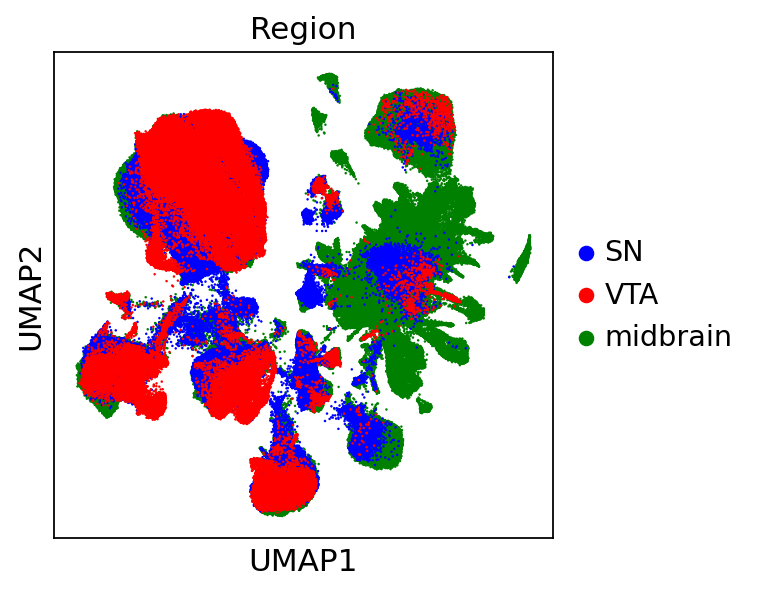

In [80]:
unique_values_sorted=['midbrain','SN','VTA']
custom_order = []
for value in unique_values_sorted:
    indices = adata_integrated.obs[adata_integrated.obs['region'] == value].index
    custom_order.extend(indices)
adata = adata_integrated[custom_order, :]

sc.pl.umap(adata, color=['region'], title='Region',
               use_raw=False, s=5,save='_region.png',palette=['b','r','g'])

/home/hers_basak/jjiang/jack/miniconda/envs/scarches2/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:1207: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if not is_categorical_dtype(values):
/home/hers_basak/jjiang/jack/miniconda/envs/scarches2/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:1216: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/home/hers_basak/jjiang/jack/miniconda/envs/scarches2/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:391: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


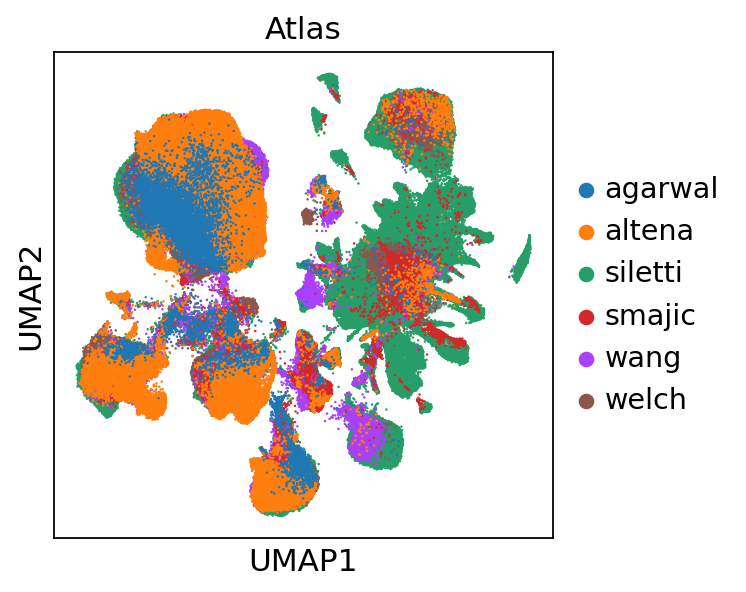

In [18]:
unique_values_sorted=['siletti','welch','wang','smajic','altena','agarwal']
custom_order = []
for value in unique_values_sorted:
    indices = adata_integrated.obs[adata_integrated.obs['atlas'] == value].index
    custom_order.extend(indices)
adata = adata_integrated[custom_order, :]
sc.pl.umap(adata, color=['atlas'], title='Atlas',
               use_raw=False, s=5,save='_atlas_before.png')

In [21]:
adata

View of AnnData object with n_obs × n_vars = 522220 × 2000
    obs: 'species', 'gender', 'age', 'instrument', 'technology', 'atlas', 'sample', 'batch_1', 'doublet_score', 'predicted_doublet', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'total_counts_mt', 'log1p_total_counts_mt', 'pct_counts_mt', 'total_counts_ribo', 'log1p_total_counts_ribo', 'pct_counts_ribo', 'n_genes', 'total_counts_mito', 'total_counts_norm', 'original_Library', 'original_Brain_Region', 'original_Level_1_cell_type', 'original_Level_2_cell_type', 'original_cellclass_lvl1', 'original_subclass_lvl3_1', 'original_cellclass_lvl1_n', 'original_lineage', 'original_subclass_lvl2', 'original_celltype_lvl3', 'donor', 'original_supercluster_term', 'original_cluster_id', 'original_subcluster_id', 'original_celltype', 'cell_type_lvl1', 'cell_type_lvl2', 'cell_type_lvl3', '_scvi_batch', '_scvi_labels', 'leiden', 'cell_type_low_res', 'cell_type_high_res', 'harmonized_cell_type', 'harmoniz

/home/hers_basak/jjiang/jack/miniconda/envs/scarches2/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:1207: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if not is_categorical_dtype(values):
/home/hers_basak/jjiang/jack/miniconda/envs/scarches2/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:1216: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/home/hers_basak/jjiang/jack/miniconda/envs/scarches2/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:391: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


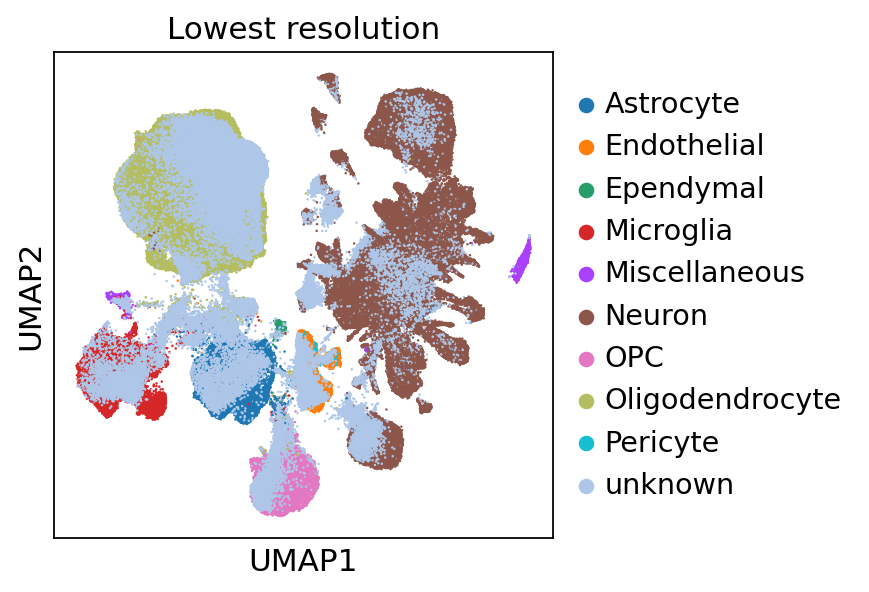

In [71]:
adata_integrated[adata_integrated.obs_names.argsort()]
sc.pl.umap(adata_integrated, color=['harmonized_lowest'], title='Lowest resolution',
               use_raw=False, s=5,save='_label_before.png')

After prediction filter

/home/hers_basak/jjiang/jack/miniconda/envs/scarches2/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:1207: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if not is_categorical_dtype(values):
/home/hers_basak/jjiang/jack/miniconda/envs/scarches2/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:1216: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/home/hers_basak/jjiang/jack/miniconda/envs/scarches2/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:391: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


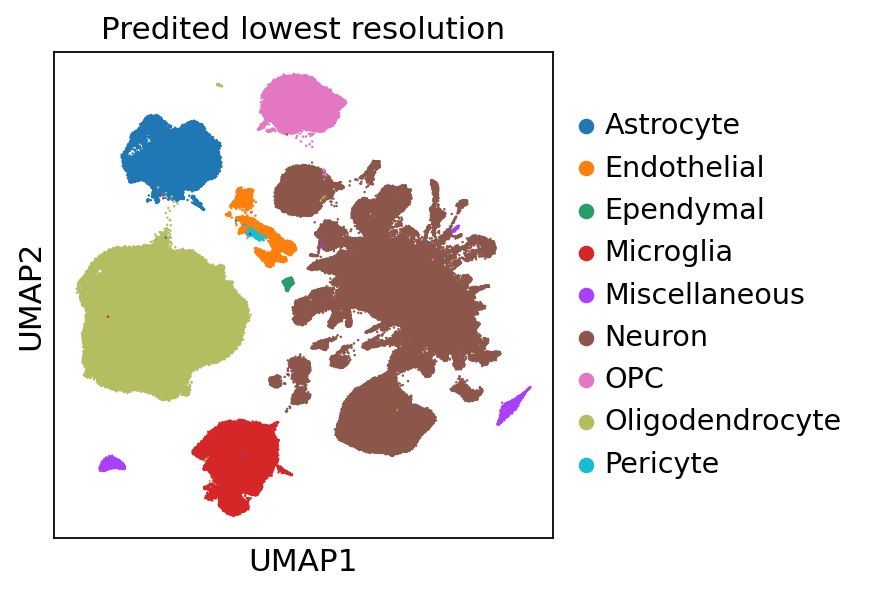

In [49]:
sc.pl.umap(adata_integrated, color=['harmonized_lowest_predicted'], title='Predited lowest resolution',
               use_raw=False, s=5, wspace=0.5,save='_atlas_lowest_predicted.png')

/home/hers_basak/jjiang/jack/miniconda/envs/scarches2/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:1169: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if groups and is_categorical_dtype(values):
/home/hers_basak/jjiang/jack/miniconda/envs/scarches2/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:1207: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if not is_categorical_dtype(values):
/home/hers_basak/jjiang/jack/miniconda/envs/scarches2/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:1216: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd

/home/hers_basak/jjiang/jack/miniconda/envs/scarches2/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:391: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/hers_basak/jjiang/jack/miniconda/envs/scarches2/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:1169: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if groups and is_categorical_dtype(values):
/home/hers_basak/jjiang/jack/miniconda/envs/scarches2/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:1207: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if not is_categorical_dtype(values):
/home/hers_basak/jjiang/jack/miniconda/envs/scarches2/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:1216: FutureWarning: The defa

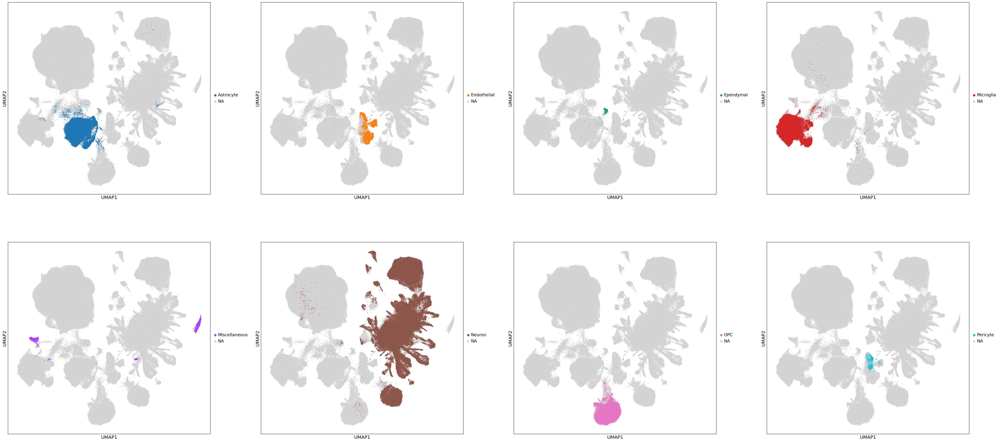

In [73]:
values=['Astrocyte',
 'Endothelial',
 'Ependymal',
 'Microglia',
 'Miscellaneous',
 'Neuron',
 'OPC',
 'Pericyte']
feature1='harmonized_lowest'
title1=''
fig, axs = plt.subplots(2, 4, figsize = [52,24])
#axs[-1, -1].axis('off')
fig.subplots_adjust(left=None, bottom=None, right=None, top=None, wspace=0.25, hspace=0.25)
sc.pl.umap(adata_integrated, color=feature1, groups= values[0], use_raw=False, s=10, ax= axs[0,0],show=False, title=title1)
sc.pl.umap(adata_integrated, color=feature1, groups= values[1], use_raw=False, s=10, ax= axs[0,1],show=False, title=title1)
sc.pl.umap(adata_integrated, color=feature1, groups= values[2], use_raw=False, s=10, ax= axs[0,2],show=False, title=title1)
sc.pl.umap(adata_integrated, color=feature1, groups= values[3], use_raw=False, s=10, ax= axs[0,3],show=False, title=title1)
sc.pl.umap(adata_integrated, color=feature1, groups= values[4], use_raw=False, s=10, ax= axs[1,0],show=False, title=title1)
sc.pl.umap(adata_integrated, color=feature1, groups= values[5], use_raw=False, s=10, ax= axs[1,1],show=False, title=title1)
sc.pl.umap(adata_integrated, color=feature1, groups= values[6], use_raw=False, s=10, ax= axs[1,2],show=False, title=title1)
sc.pl.umap(adata_integrated, color=feature1, groups= values[7], use_raw=False, s=10, ax= axs[1,3],show=False, title=title1)
fig.savefig(f'/home/hers_basak/jjiang/jack/outputs/deliverables/6_analysis/umap_subplots_predicted_labels_before.png',bbox_inches='tight')

In [58]:
adata_integrated.obs['harmonized_lowest']

10X173_3:CATGCAAGTTAGAGAT    Astrocyte
10X173_3:GTAGTACTCCCTCTAG    Astrocyte
10X173_3:AGTAGCTAGCATCTTG    Astrocyte
10X173_3:TGCGGCAGTCCACTCT    Astrocyte
10X173_3:TACCCGTTCAAACTGC    Astrocyte
                               ...    
N5B_GTCACAAAGAGTAATC           unknown
N5B_CACAAACAGTGTACTC           unknown
N5B_CTGCGGAAGTCATCCA           unknown
N5B_GCGAGAAAGGTGTTAA           unknown
N5B_ATTTCTGTCATGTAGC           unknown
Name: harmonized_lowest, Length: 346318, dtype: category
Categories (9, object): ['Astrocyte', 'Endothelial', 'Ependymal', 'Microglia', ..., 'Neuron', 'OPC', 'Pericyte', 'unknown']

/home/hers_basak/jjiang/jack/miniconda/envs/scarches2/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:1169: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if groups and is_categorical_dtype(values):
/home/hers_basak/jjiang/jack/miniconda/envs/scarches2/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:1207: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if not is_categorical_dtype(values):
/home/hers_basak/jjiang/jack/miniconda/envs/scarches2/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:1216: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd

/home/hers_basak/jjiang/jack/miniconda/envs/scarches2/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:391: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/hers_basak/jjiang/jack/miniconda/envs/scarches2/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:1169: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if groups and is_categorical_dtype(values):
/home/hers_basak/jjiang/jack/miniconda/envs/scarches2/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:1207: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if not is_categorical_dtype(values):
/home/hers_basak/jjiang/jack/miniconda/envs/scarches2/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:1216: FutureWarning: The defa

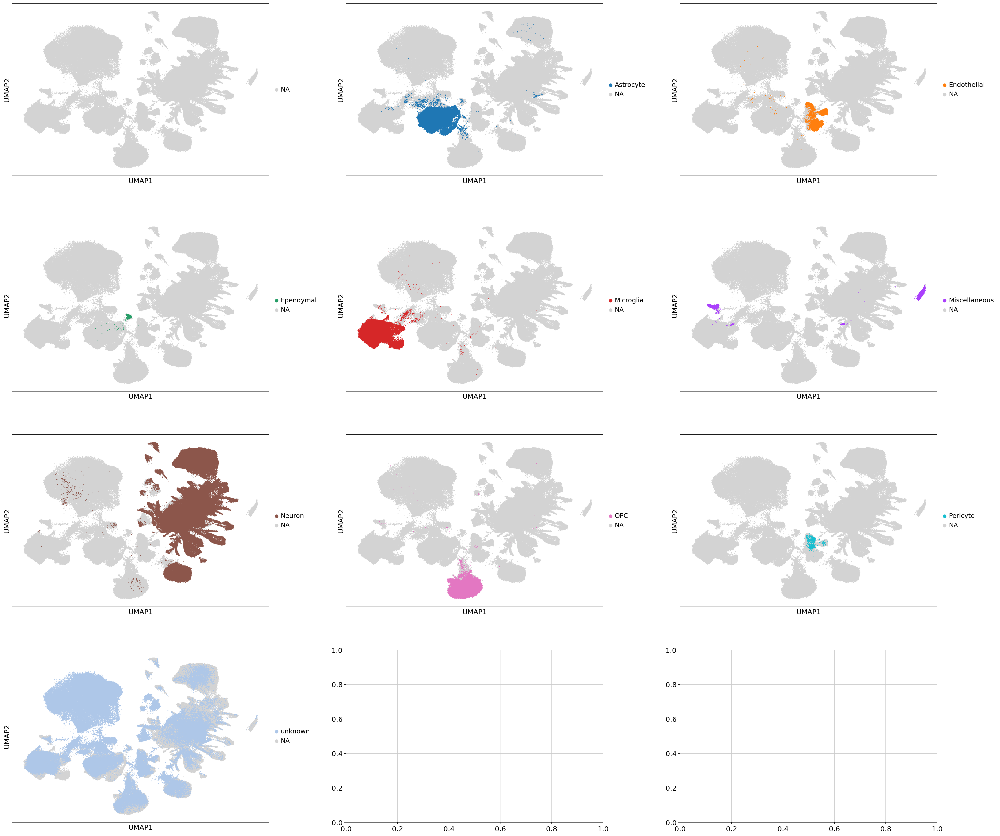

In [57]:
values=['Oligodendrocyte',
'Astrocyte',
 'Endothelial',
 'Ependymal',
 'Microglia',
 'Miscellaneous',
 'Neuron',
 'OPC',
 'Pericyte',
 'unknown']
feature1='harmonized_lowest'
title1=''
fig, axs = plt.subplots(4, 3, figsize = [33,30])
#axs[-1, -1].axis('off')
fig.subplots_adjust(left=None, bottom=None, right=None, top=None, wspace=0.3, hspace=0.25)
sc.pl.umap(adata_integrated, color=feature1, groups= values[0], use_raw=False, s=10, ax= axs[0,0],show=False, title=title1)
sc.pl.umap(adata_integrated, color=feature1, groups= values[1], use_raw=False, s=10, ax= axs[0,1],show=False, title=title1)
sc.pl.umap(adata_integrated, color=feature1, groups= values[2], use_raw=False, s=10, ax= axs[0,2],show=False, title=title1)
sc.pl.umap(adata_integrated, color=feature1, groups= values[3], use_raw=False, s=10, ax= axs[1,0],show=False, title=title1)
sc.pl.umap(adata_integrated, color=feature1, groups= values[4], use_raw=False, s=10, ax= axs[1,1],show=False, title=title1)
sc.pl.umap(adata_integrated, color=feature1, groups= values[5], use_raw=False, s=10, ax= axs[1,2],show=False, title=title1)
sc.pl.umap(adata_integrated, color=feature1, groups= values[6], use_raw=False, s=10, ax= axs[2,0],show=False, title=title1)
sc.pl.umap(adata_integrated, color=feature1, groups= values[7], use_raw=False, s=10, ax= axs[2,1],show=False, title=title1)
sc.pl.umap(adata_integrated, color=feature1, groups= values[8], use_raw=False, s=10, ax= axs[2,2],show=False, title=title1)

sc.pl.umap(adata_integrated, color=feature1, groups= values[9], use_raw=False, s=10, ax= axs[3,0],show=False, title=title1)
fig.savefig(f'/home/hers_basak/jjiang/jack/outputs/deliverables/6_analysis/umap_subplots_original_labels_before.png',bbox_inches='tight')

/home/hers_basak/jjiang/jack/miniconda/envs/scarches2/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:1207: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if not is_categorical_dtype(values):
/home/hers_basak/jjiang/jack/miniconda/envs/scarches2/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:1216: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/home/hers_basak/jjiang/jack/miniconda/envs/scarches2/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:391: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


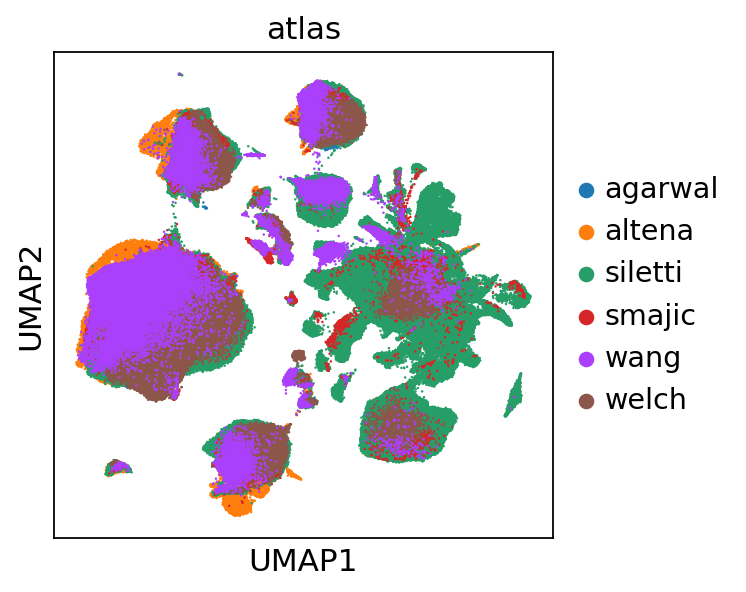

In [8]:
sc.settings.figdir = '/home/hers_basak/jjiang/jack/outputs/deliverables/6_analysis/'
sc.pl.umap(adata_integrated, color=['atlas'], 
               use_raw=False, s=5, wspace=0.5,save='_atlas_lowest.png')

/home/hers_basak/jjiang/jack/miniconda/envs/scarches2/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:1169: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if groups and is_categorical_dtype(values):
/home/hers_basak/jjiang/jack/miniconda/envs/scarches2/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:1207: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if not is_categorical_dtype(values):
/home/hers_basak/jjiang/jack/miniconda/envs/scarches2/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:1216: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd

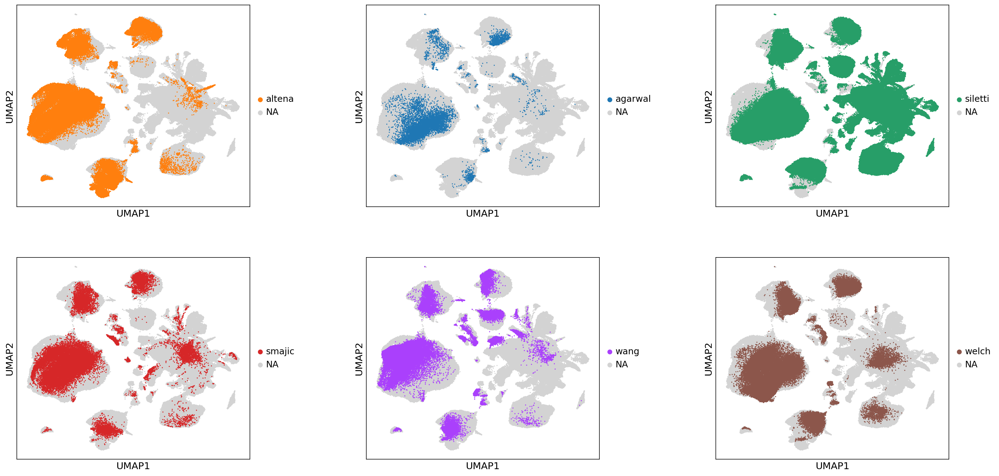

In [60]:
feature1='atlas'
title1=''
fig, axs = plt.subplots(2, 3, figsize = [24,12])
#axs[-1, -1].axis('off')
fig.subplots_adjust(left=None, bottom=None, right=None, top=None, wspace=0.5, hspace=0.25)
sc.pl.umap(adata_integrated, color=feature1, groups= 'altena', use_raw=False, s=10, ax= axs[0,0],show=False, title=title1)
sc.pl.umap(adata_integrated, color=feature1, groups= 'agarwal', use_raw=False, s=10, ax= axs[0,1],show=False, title=title1)
sc.pl.umap(adata_integrated, color=feature1, groups= 'siletti', use_raw=False, s=10, ax= axs[0,2],show=False, title=title1)
sc.pl.umap(adata_integrated, color=feature1, groups= 'smajic', use_raw=False, s=10, ax= axs[1,0],show=False, title=title1)
sc.pl.umap(adata_integrated, color=feature1, groups= 'wang', use_raw=False, s=10, ax= axs[1,1],show=False, title=title1)
sc.pl.umap(adata_integrated, color=feature1, groups= 'welch', use_raw=False, s=10, ax= axs[1,2],show=False, title=title1)
fig.savefig(f'/home/hers_basak/jjiang/jack/outputs/deliverables/6_analysis/umap_atlas_subplots_lowest.png',bbox_inches='tight')

## Proportions

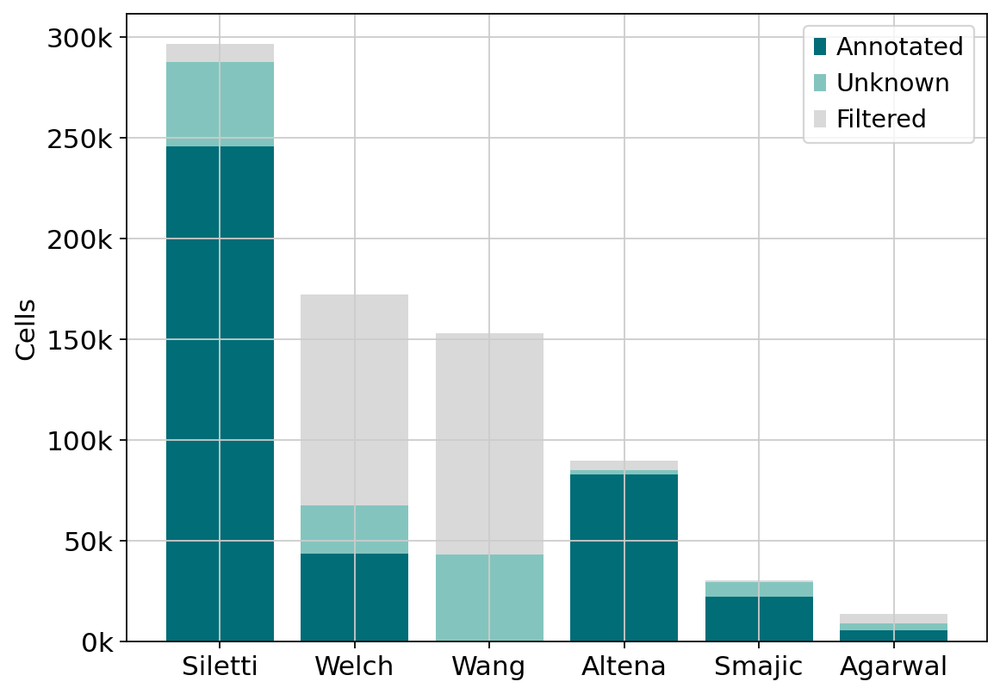

In [6]:
import matplotlib.ticker as ticker
categories = ['Siletti','Welch', 'Wang','Altena','Smajic','Agarwal']
remaining = [245615,43795,0,83138,22279,5903]
unknown=[41908,23672,43477,1906,7216,3311]
filtered = [9191,104670,109422,4932,806, 4466] 


plt.figure(figsize=(8, 6))
plt.bar(categories, remaining, label='Annotated',color='#006d77')
plt.bar(categories, unknown, bottom=remaining, label='Unknown',color='#83c5be')
plt.bar(categories, filtered, bottom=[i + j for i, j in zip(remaining, unknown)],label='Filtered',color='#d9d9d9')


plt.xlabel('')
plt.ylabel('Cells')
plt.title('')
plt.legend()
def format_func(value, tick_number):
    return f'{value/1000:.0f}k'
plt.gca().yaxis.set_major_formatter(ticker.FuncFormatter(format_func))
plt.savefig('stacked_filtering.png', dpi=300, bbox_inches='tight')  

plt.show()



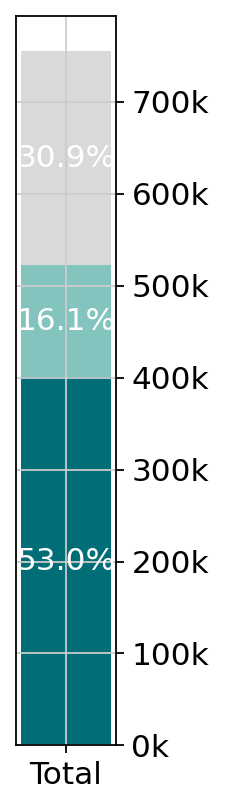

In [7]:
import matplotlib.ticker as ticker
categories = ['Total']
remaining = [400730]
unknown=[121490]
filtered = [233487] 
total = [sum(x) for x in zip(remaining, unknown, filtered)]

plt.figure(figsize=(0.8, 6))
bars=plt.bar(categories, remaining, label='Annotated',color='#006d77')
bars_unknown=plt.bar(categories, unknown, bottom=remaining, label='Unknown',color='#83c5be')
bars_filtered=plt.bar(categories, filtered, bottom=[i + j for i, j in zip(remaining, unknown)],label='Filtered',color='#d9d9d9')


plt.xlabel('')
plt.ylabel('')
plt.title('')
def format_func(value, tick_number):
    return f'{value/1000:.0f}k'
plt.gca().yaxis.set_major_formatter(ticker.FuncFormatter(format_func))
plt.gca().yaxis.set_ticks_position('right')
def add_percentage(bars):
    for bar in bars:
        height = bar.get_height()
        percentage = height / sum(total) * 100
        plt.text(bar.get_x() + bar.get_width() / 2, bar.get_y() + bar.get_height() / 2,
                 f'{percentage:.1f}%', ha='center', va='center', color='white')

add_percentage(bars)
add_percentage(bars_unknown)
add_percentage(bars_filtered)

plt.savefig('stacked_filtering_total.png', dpi=300, bbox_inches='tight')  

plt.show()



/scratch/12105043/ipykernel_2949302/3498550219.py:1: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  proportions = adata_integrated.obs.groupby(['harmonized_lowest', 'atlas']).size().unstack().div(adata_integrated.obs.groupby('harmonized_lowest').size(), axis=0)


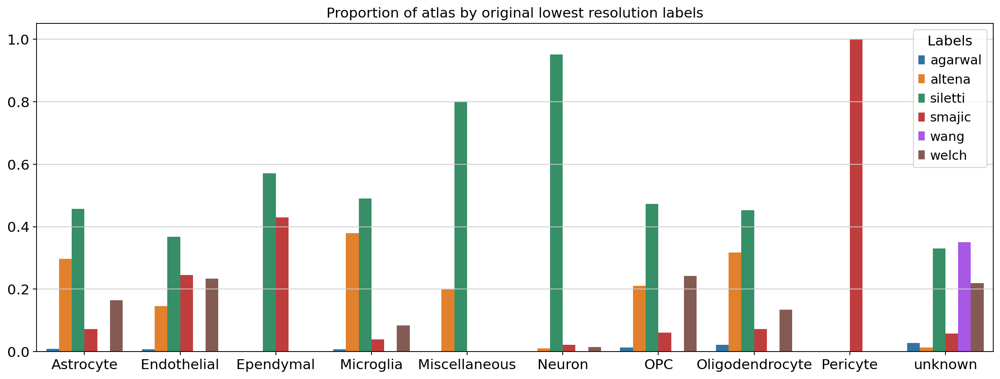

In [40]:
proportions = adata_integrated.obs.groupby(['harmonized_lowest', 'atlas']).size().unstack().div(adata_integrated.obs.groupby('harmonized_lowest').size(), axis=0)

proportions_df = proportions.reset_index()

melted = pd.melt(proportions_df, id_vars='harmonized_lowest', var_name='atlas', value_name='Proportion')

plt.figure(figsize=(17, 6))
sns.barplot(x='harmonized_lowest', y='Proportion', hue='atlas', data=melted)
plt.title('Proportion of atlas by original lowest resolution labels')
plt.xlabel('')
plt.ylabel('')
plt.legend(title='Labels',bbox_to_anchor=(1, 1))
plt.savefig('/home/hers_basak/jjiang/jack/outputs/deliverables/6_analysis/proportion_atlas.png', dpi=300, bbox_inches='tight')
plt.show()

Needed some stats for the excel sheet

In [70]:
adata_integrated.obs['total_counts']=adata_integrated.obs['total_counts'].astype(int).tolist()
adata_integrated.obs['pct_counts_mt']=adata_integrated.obs['pct_counts_mt'].astype(float).tolist()

mean_values = adata_integrated.obs.groupby('atlas')['total_counts'].mean()
median_values = adata_integrated.obs.groupby('atlas')['total_counts'].median()
mean_mt = adata_integrated.obs.groupby('atlas')['pct_counts_mt'].mean()
median_mt = adata_integrated.obs.groupby('atlas')['pct_counts_mt'].median()

/scratch/12169123/ipykernel_499275/2749120938.py:4: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_values = adata_integrated.obs.groupby('atlas')['total_counts'].mean()
/scratch/12169123/ipykernel_499275/2749120938.py:5: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  median_values = adata_integrated.obs.groupby('atlas')['total_counts'].median()
/scratch/12169123/ipykernel_499275/2749120938.py:6: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and 

In [73]:
adata_integrated.obs['pct_counts_ribo']=adata_integrated.obs['pct_counts_ribo'].astype(float).tolist()


mean_ribo = adata_integrated.obs.groupby('atlas')['pct_counts_ribo'].mean()
median_ribo = adata_integrated.obs.groupby('atlas')['pct_counts_ribo'].median()

/scratch/12169123/ipykernel_499275/4115207731.py:4: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_ribo = adata_integrated.obs.groupby('atlas')['pct_counts_ribo'].mean()
/scratch/12169123/ipykernel_499275/4115207731.py:5: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  median_ribo = adata_integrated.obs.groupby('atlas')['pct_counts_ribo'].median()


In [76]:
adata_integrated.obs['n_genes']=adata_integrated.obs['n_genes'].astype(int).tolist()


mean_genes = adata_integrated.obs.groupby('atlas')['n_genes'].mean()
median_genes = adata_integrated.obs.groupby('atlas')['n_genes'].median()

/scratch/12169123/ipykernel_499275/3750804108.py:4: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_genes = adata_integrated.obs.groupby('atlas')['n_genes'].mean()
/scratch/12169123/ipykernel_499275/3750804108.py:5: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  median_genes = adata_integrated.obs.groupby('atlas')['n_genes'].median()


In [89]:
adata_integrated.obs['pct_counts_ribo'].median()

0.7293354943273906

In [13]:
adata_integrated.obs['harmonized_lowest'].value_counts()

harmonized_lowest
Oligodendrocyte    230390
Neuron             157244
Microglia           41173
Astrocyte           39179
OPC                 30575
Endothelial          5794
Miscellaneous        2377
Ependymal             563
Pericyte              468
Name: count, dtype: int64

In [7]:
adata_integrated.obs['atlas'][adata_integrated.obs['harmonized_lowest_filtered_02_scvi']=='MISC-siletti'].value_counts()

atlas
siletti    1757
altena      416
wang        103
welch        63
smajic       34
agarwal       4
Name: count, dtype: int64

In [8]:
adata_integrated.obs['atlas'][adata_integrated.obs['harmonized_lowest_filtered_02_scvi']=='ENDO-welch'].value_counts()

atlas
siletti    1495
wang       1228
welch      1035
altena      491
smajic       81
agarwal      64
Name: count, dtype: int64

In [9]:
adata_integrated.obs['atlas'][adata_integrated.obs['harmonized_lowest_filtered_02_scvi']=='Endothelial cells-smajic'].value_counts()

atlas
smajic     858
wang       526
altena       9
siletti      3
welch        3
agarwal      1
Name: count, dtype: int64

In [5]:
adata_integrated.obs['harmonized_lowest_filtered_02_scvi'].value_counts()

harmonized_lowest_filtered_02_scvi
OLIGO-siletti               230390
NEUR-siletti                157244
Microglia-smajic             41173
Astrocytes-smajic            39179
OPC-siletti                  30575
ENDO-welch                    4394
MISC-siletti                  2377
Endothelial cells-smajic      1400
EPEN-siletti                   563
Pericytes-smajic               468
Name: count, dtype: int64

In [19]:
set(adata_integrated.obs['harmonized_lowest_filtered_02_scvi'].tolist())

{'Astrocytes-smajic',
 'ENDO-welch',
 'EPEN-siletti',
 'Endothelial cells-smajic',
 'MISC-siletti',
 'Microglia-smajic',
 'NEUR-siletti',
 'OLIGO-siletti',
 'OPC-siletti',
 'Pericytes-smajic'}

## Check markers

In [69]:
adata_all=sc.read_h5ad('/home/hers_basak/jjiang/jack/outputs/deliverables/5_integration/data/scvi/models/scvi_model_final/adata_predicted_lowest_filtered_5k.h5ad')

In [72]:
print(adata_all)

AnnData object with n_obs × n_vars = 507763 × 5000
    obs: 'species', 'gender', 'age', 'instrument', 'technology', 'atlas', 'sample', 'batch_1', 'doublet_score', 'predicted_doublet', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'total_counts_mt', 'log1p_total_counts_mt', 'pct_counts_mt', 'total_counts_ribo', 'log1p_total_counts_ribo', 'pct_counts_ribo', 'n_genes', 'total_counts_mito', 'total_counts_norm', 'original_Library', 'original_Brain_Region', 'original_Level_1_cell_type', 'original_Level_2_cell_type', 'original_cellclass_lvl1', 'original_subclass_lvl3_1', 'original_cellclass_lvl1_n', 'original_lineage', 'original_subclass_lvl2', 'original_celltype_lvl3', 'donor', 'original_supercluster_term', 'original_cluster_id', 'original_subcluster_id', 'original_celltype', 'cell_type_lvl1', 'cell_type_lvl2', 'cell_type_lvl3', 'harmonized_lowest_filtered_02_scvi', 'cell_type_low_res', 'cell_type_high_res', 'harmonized_cell_type', 'harmonized_lowest_u

In [73]:
#sc.tl.pca(adata_integrated, svd_solver='arpack')
sc.pp.neighbors(adata_all, n_pcs=90,n_neighbors=30,use_rep='X_scVI')

sc.tl.umap(adata_all)

In [113]:
a = adata_all[adata_all[: , 'GFAP'].X > 4, :]

In [114]:
sus_oligo = a[a.obs['harmonized_lowest_predicted']=='Oligodendrocyte']

In [130]:
np.mean([float(x) for x in sus_oligo.obs['pct_counts_mt']])

5.4811067507191

In [116]:
sus_oligo.obs['cell_type_lowest_res'].value_counts()

cell_type_lowest_res
Unknown-wang               102
Unknown-smajic               2
Oligodendrocytes-smajic      1
Unknown-altena               1
Unknown-welch                1
Name: count, dtype: int64

In [163]:
b = adata_all[adata_all[: , 'PLP1'].X > 3.5, :]

In [164]:
sus_all = b[b.obs['harmonized_lowest_predicted']!='Oligodendrocyte']

In [165]:
sus_all.obs['atlas'].value_counts()

atlas
siletti    414
wang       193
smajic      74
agarwal     57
altena      27
welch       14
Name: count, dtype: int64

In [166]:
sus_all.obs['cell_type_lowest_res'].value_counts()

cell_type_lowest_res
Unknown-siletti             401
Unknown-wang                192
Unknown-smajic               60
OPC-agarwal                  23
Unknown-altena               21
Astrocytes-agarwal           16
OPC-siletti                  11
ODC-agarwal                  10
Unknown-welch                10
Microglia-smajic              8
Unknown-agarwal               5
OPC-altena                    3
OPCs-smajic                   3
Microglia-agarwal             3
NEURO-welch                   2
NEUR-siletti                  2
Astrocytes-smajic             2
Astrocyte-altena              2
Microglia-altena              1
OPC-welch                     1
MG-welch                      1
Endothelial cells-smajic      1
Name: count, dtype: int64

In [175]:
print(sus_all[(sus_all.obs['atlas']=='agarwal')& (sus_all.obs['cell_type_lowest_res']=='Astrocytes-agarwal')][:,'PLP1'].X)

  (0, 0)	4.2223873
  (1, 0)	3.7332869
  (2, 0)	3.8842273
  (3, 0)	3.5014856
  (4, 0)	3.5026662
  (5, 0)	3.9765725
  (6, 0)	3.9088423
  (7, 0)	3.6828535
  (8, 0)	3.5055497
  (9, 0)	3.916628
  (10, 0)	3.9295409
  (11, 0)	3.5463662
  (12, 0)	3.8598368
  (13, 0)	3.6914992
  (14, 0)	3.5551705
  (15, 0)	3.5015202


In [118]:
sus_astro = b[b.obs['harmonized_lowest_predicted']=='Astrocyte']

In [119]:
sus_astro.obs['atlas'].value_counts()

atlas
wang       15
siletti    14
agarwal     5
smajic      3
altena      2
welch       2
Name: count, dtype: int64

In [122]:
sus_astro.obs['cell_type_lowest_res'].value_counts()

cell_type_lowest_res
Unknown-wang          15
Unknown-siletti       14
ODC-agarwal            3
Astrocytes-smajic      2
Unknown-welch          2
Astrocyte-altena       1
Astrocytes-agarwal     1
Unknown-agarwal        1
Unknown-altena         1
Unknown-smajic         1
Name: count, dtype: int64

In [160]:
c = adata_all[adata_all[: , 'TH'].X > 2, :]

In [161]:
sus_dopa = c[c.obs['harmonized_lowest_predicted']=='Oligodendrocyte']

In [162]:
sus_dopa.obs['cell_type_lowest_res'].value_counts()

cell_type_lowest_res
OLIGO-welch               125
Unknown-welch              64
Unknown-altena             36
Unknown-wang               17
Oligodendrocyte-altena      8
OLIGO-siletti               3
Unknown-agarwal             2
NEURO-welch                 1
ODC-agarwal                 1
Unknown-siletti             1
Unknown-smajic              1
Name: count, dtype: int64

In [104]:
np.median([float(x) for x in (sus_oligo.obs['pct_counts_mt'].tolist())])

5.336830463450381

/home/hers_basak/jjiang/jack/miniconda/envs/scarches2/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:1207: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if not is_categorical_dtype(values):


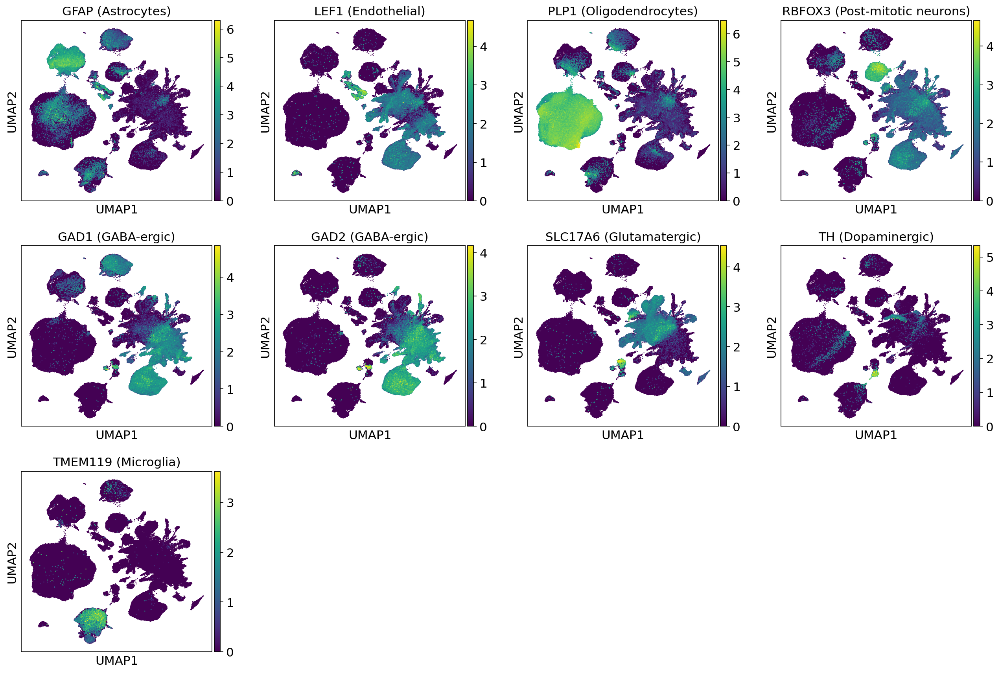

In [157]:
markers=['GFAP','LEF1', 'PLP1', 'RBFOX3','GAD1','GAD2', 'SLC17A6','TH','TMEM119']
title=['GFAP (Astrocytes)','LEF1 (Endothelial)', 'PLP1 (Oligodendrocytes)', 'RBFOX3 (Post-mitotic neurons)', 'GAD1 (GABA-ergic)','GAD2 (GABA-ergic)', 'SLC17A6 (Glutamatergic)', 'TH (Dopaminergic)','TMEM119 (Microglia)']
title=title
sc.pl.umap(adata_all, color=markers, title=title, use_raw=False, s=5,save = "_all_markers.png")

## Sankey

In [65]:
def prepare_labels(adata):    
    low=adata.obs['cell_type_lvl1'].tolist()
    med=adata.obs['cell_type_lvl2'].tolist()
    high=adata.obs['cell_type_lvl3'].tolist()
    atlas=adata.obs['atlas'].tolist()

    siletti_supercluster=['Miscellaneous', 'Microglia', 'Vascular', 'Fibroblast', 'Oligodendrocyte precursor', 'Committed oligodendrocyte precursor', 'Oligodendrocyte', 'Bergmann glia', 'Astrocyte', 'Ependymal', 'Choroid plexus', 'Deep-layer near-projecting', 'Deep-layer corticothalamic and 6b', 'Hippocampal CA1-3', 'Upper-layer intratelencephalic', 'Deep-layer intratelencephalic', 'Amygdala excitatory', 'Hippocampal CA4', 'Hippocampal dentate gyrus', 'Medium spiny neuron', 'Eccentric medium spiny neuron', 'Splatter', 'MGE interneuron', 'LAMP5-LHX6 and Chandelier', 'CGE interneuron', 'Upper rhombic lip', 'Cerebellar inhibitory', 'Lower rhombic lip', 'Mammillary body', 'Thalamic excitatory', 'Midbrain-derived inhibitory']
    siletti_class=['MISC', 'MGL', 'ENDO', 'FIB', 'OPC', 'OLIGO', 'OLIGO', 'ASTRO', 'ASTRO', 'EPEN', 'CHRP', 'NEUR', 'NEUR', 'NEUR', 'NEUR', 'NEUR', 'NEUR', 'NEUR', 'NEUR', 'NEUR', 'NEUR', 'NEUR', 'NEUR','NEUR', 'NEUR', 'NEUR', 'NEUR', 'NEUR', 'NEUR', 'NEUR', 'NEUR']

    cell_type_lowest_res = list()
    cell_type_low_res = list()
    cell_type_med_res = list()
    cell_type_high_res = list()

    for i in range(len(adata.obs_names)):
        if low[i] in ['','None']:
            cell_type_lowest_res.append('Unknown') #lowest
            cell_type_low_res.append('Unknown') #low
            cell_type_med_res.append('Unknown') #med
            cell_type_high_res.append('Unknown') #high
        else:
            
            cell_type_low_res.append(str(low[i]).replace('_','-')) #low

            if atlas[i]!='siletti':
                if high[i]!= '':
                    cell_type_high_res.append(str(high[i]).replace('_','-'))
                    cell_type_med_res.append(str(high[i]).replace('_','-'))
                elif med[i]!= '':
                    cell_type_high_res.append(str(med[i]).replace('_','-'))
                    cell_type_med_res.append(str(med[i]).replace('_','-'))
                else:
                    cell_type_high_res.append(str(low[i]).replace('_','-'))
                    cell_type_med_res.append(str(low[i]).replace('_','-'))

            if atlas[i]=='siletti':
                cell_index=siletti_supercluster.index(low[i])
                cell_type_lowest_res.append(str(siletti_class[cell_index]).replace('_','-'))#lowest
                cell_type_high_res.append(str(high[i]).replace('_','-'))#high
                cell_type_med_res.append(str(med[i]).replace('_','-'))#med
            elif atlas[i]=='welch':

                if 'ASTRO' in low[i]:
                    cell_type_lowest_res.append('ASTRO')#lowest
                elif 'ENDO' in low[i]:
                    cell_type_lowest_res.append('ENDO')#lowest
                elif 'NEURO' in low[i]:
                    cell_type_lowest_res.append('NEURO')#lowest
                elif 'OLIGO' in low[i]:
                    cell_type_lowest_res.append('OLIGO')#lowest
                elif 'OPC' in low[i]:
                    cell_type_lowest_res.append('OPC')#lowest
                elif 'MG' in low[i]:
                    cell_type_lowest_res.append('MG')#lowest
            elif atlas[i]=='smajic':
                if 'DaNs' in low[i]:
                    cell_type_lowest_res.append('Neuron')#lowest
                elif 'CADPS2+ neurons' in low[i]:
                    cell_type_lowest_res.append('Neuron')#lowest
                elif 'Excitatory' in low[i]:
                    cell_type_lowest_res.append('Neuron')#lowest
                elif 'GABA' in low[i]:
                    cell_type_lowest_res.append('Neuron')#lowest
                elif 'Inhibitory' in low[i]:
                    cell_type_lowest_res.append('Neuron')#lowest
                else:
                    cell_type_lowest_res.append(low[i])#lowest
            elif atlas[i]=='agarwal':
                if 'DaN' in low[i]:
                    cell_type_lowest_res.append('Neuron')#lowest
                elif 'GABA neurons' in low[i]:
                    cell_type_lowest_res.append('Neuron')#lowest
                else:
                    cell_type_lowest_res.append(low[i])#lowest
            else:
                cell_type_lowest_res.append(str(low[i]).replace('_','-'))#lowest
                #high and med


    adata.obs['cell_type_lowest_res'] = cell_type_lowest_res
    adata.obs['cell_type_low_res'] = cell_type_low_res
    adata.obs['cell_type_med_res'] = cell_type_med_res
    adata.obs['cell_type_high_res'] = cell_type_high_res

    adata.obs['cell_type_high_res'] = np.char.add(np.char.add(np.array(adata.obs['cell_type_high_res'], dtype= str), '-'),
                                                 np.array(adata.obs['atlas'], dtype=str))

    adata.obs['cell_type_med_res'] = np.char.add(np.char.add(np.array(adata.obs['cell_type_med_res'], dtype= str), '-'),
                                                 np.array(adata.obs['atlas'], dtype=str))

    adata.obs['cell_type_low_res'] = np.char.add(np.char.add(np.array(adata.obs['cell_type_low_res'], dtype= str), '-'),
                                                 np.array(adata.obs['atlas'], dtype=str))

    adata.obs['cell_type_lowest_res'] = np.char.add(np.char.add(np.array(adata.obs['cell_type_lowest_res'], dtype= str), '-'),
                                                 np.array(adata.obs['atlas'], dtype=str))


In [66]:
prepare_labels(adata_integrated)

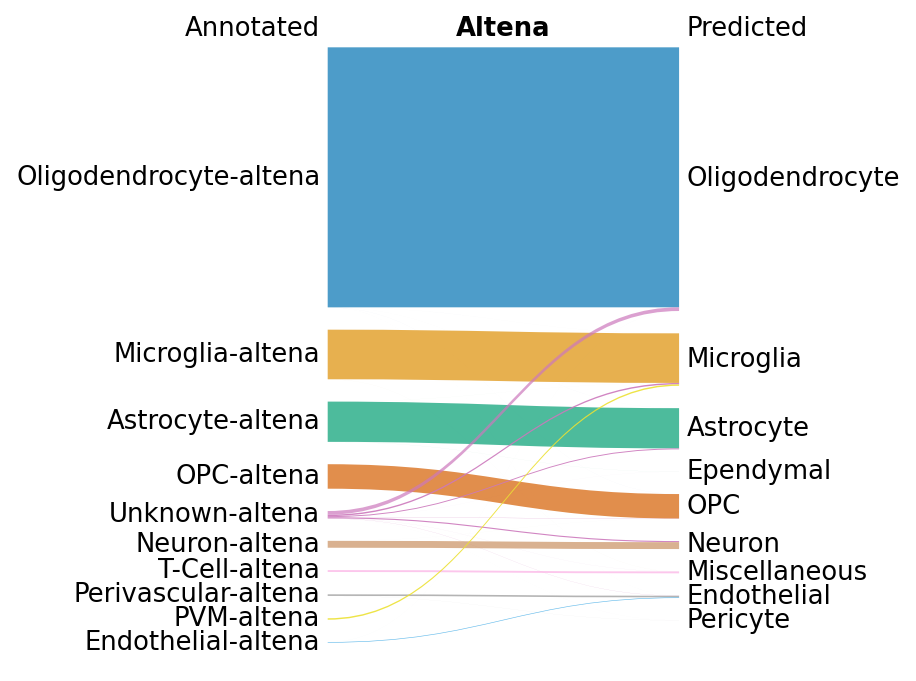

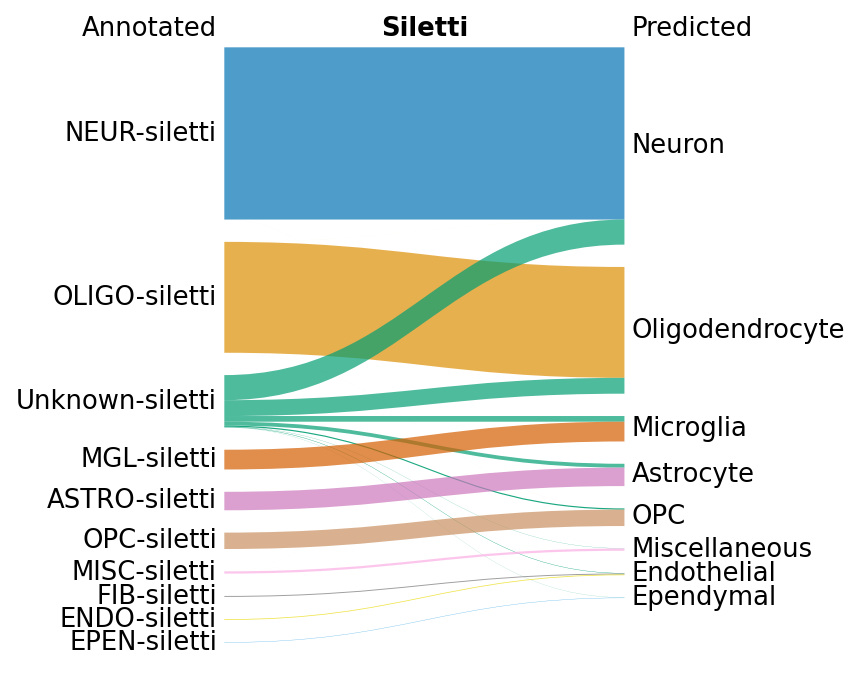

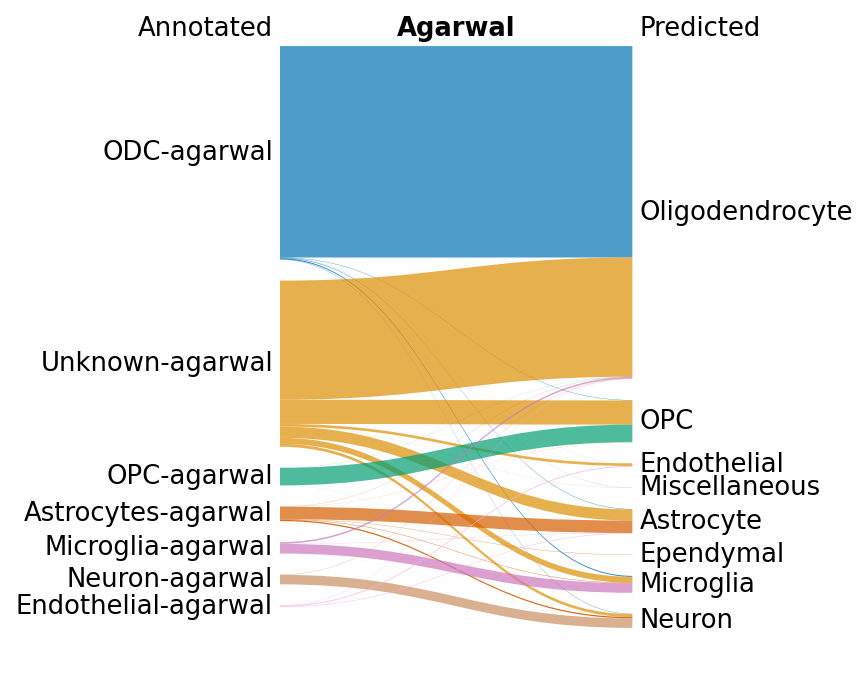

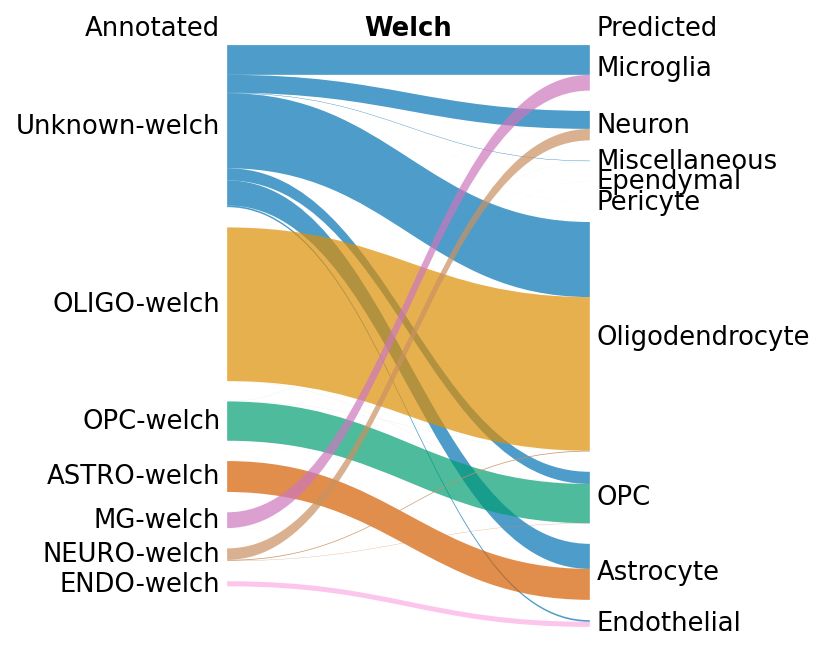

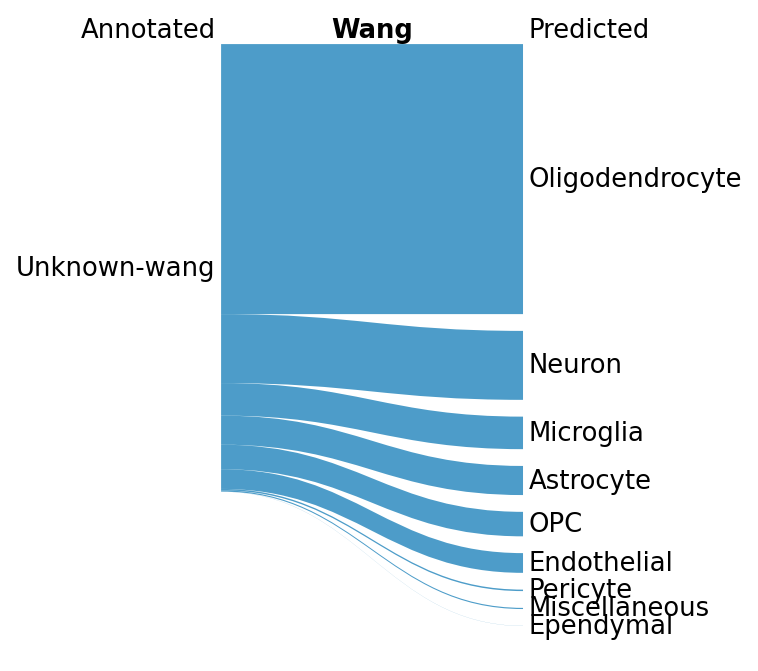

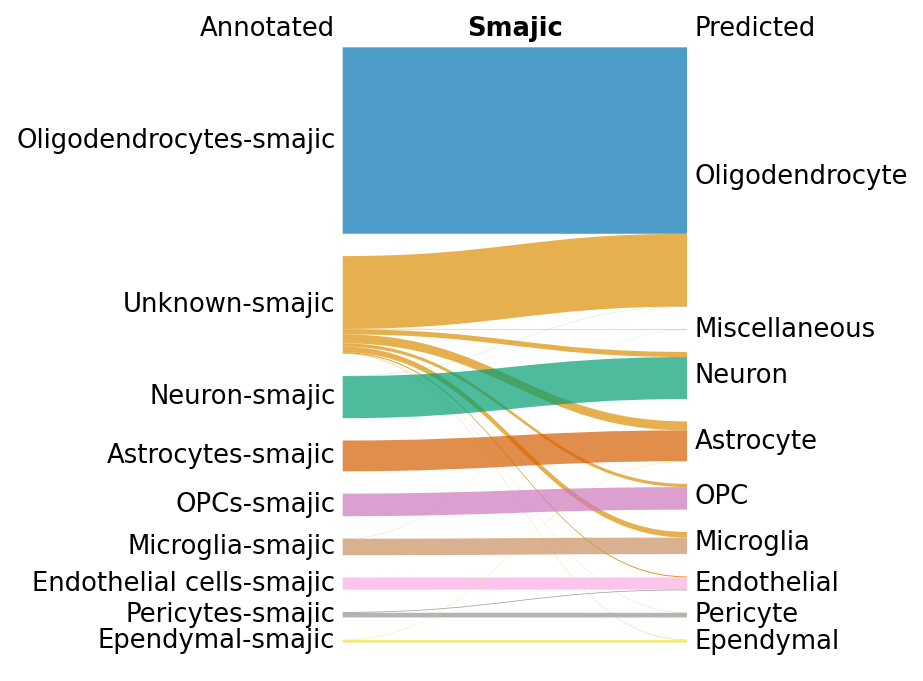

In [67]:

idx1 = (adata_integrated.obs.atlas == 'altena')
idx2 = (adata_integrated.obs.atlas == 'siletti') 

x = sankey(adata_integrated.obs['cell_type_lowest_res'][idx1],
                  adata_integrated.obs['harmonized_lowest_predicted'][idx1], save=True,
                  name_file='sankey_altena', title="Altena", title_left="Annotated",
                  title_right="Predicted", alpha=0.7,
                   fontsize='small')

x = sankey( adata_integrated.obs['cell_type_lowest_res'][idx2],
                  adata_integrated.obs['harmonized_lowest_predicted'][idx2], save=True,
                  name_file='sankey_siletti', title="Siletti", title_left="Annotated",
                  title_right="Predicted", alpha=0.7,
                  fontsize='small')

idx3 = (adata_integrated.obs.atlas == 'agarwal')
idx4 = (adata_integrated.obs.atlas == 'welch') 

x = sankey( adata_integrated.obs['cell_type_lowest_res'][idx3],
                  adata_integrated.obs['harmonized_lowest_predicted'][idx3], save=True,
                  name_file='sankey_agarwal', title="Agarwal", title_left="Annotated",
                  title_right="Predicted", alpha=0.7,
                   fontsize='small')

x = sankey( adata_integrated.obs['cell_type_lowest_res'][idx4],
                  adata_integrated.obs['harmonized_lowest_predicted'][idx4], save=True,
                  name_file='sankey_welch', title="Welch", title_left="Annotated",
                  title_right="Predicted", alpha=0.7,
                  fontsize='small')

idx5 = (adata_integrated.obs.atlas == 'wang')
idx6 = (adata_integrated.obs.atlas == 'smajic') 

x = sankey( adata_integrated.obs['cell_type_lowest_res'][idx5],
                  adata_integrated.obs['harmonized_lowest_predicted'][idx5], save=True,
                  name_file='sankey_wang', title="Wang", title_left="Annotated",
                  title_right="Predicted", alpha=0.7,
                   fontsize='small')

x = sankey( adata_integrated.obs['cell_type_lowest_res'][idx6],
                  adata_integrated.obs['harmonized_lowest_predicted'][idx6], save=True,
                  name_file='sankey_smajic', title="Smajic", title_left="Annotated",
                  title_right="Predicted", alpha=0.7,
                  fontsize='small')

## neuron only

In [144]:
a=sc.read_h5ad('/home/hers_basak/jjiang/jack/outputs/deliverables/5_integration/data/scvi/models/scvi_model_final/adata_predicted_neuron_all.h5ad')

In [63]:
b=sc.read_h5ad('/home/hers_basak/jjiang/jack/outputs/deliverables/5_integration/data/scvi/models/scvi_model_final_neuron_all/adata_5k_known.h5ad')

In [43]:
b.obs['cell_type_high_res'].value_counts().tolist()

[4680,
 4011,
 2867,
 2737,
 1985,
 1750,
 1747,
 1475,
 1380,
 1371,
 1345,
 1300,
 1087,
 1054,
 971,
 935,
 894,
 888,
 852,
 842,
 823,
 817,
 796,
 790,
 740,
 733,
 718,
 711,
 710,
 704,
 691,
 684,
 679,
 675,
 667,
 645,
 638,
 633,
 631,
 622,
 621,
 607,
 601,
 593,
 560,
 558,
 558,
 543,
 529,
 524,
 522,
 507,
 501,
 495,
 474,
 468,
 466,
 461,
 455,
 447,
 442,
 435,
 432,
 422,
 419,
 418,
 417,
 407,
 381,
 381,
 378,
 375,
 372,
 370,
 363,
 362,
 361,
 360,
 357,
 355,
 354,
 352,
 350,
 348,
 347,
 340,
 339,
 338,
 335,
 334,
 332,
 328,
 327,
 325,
 323,
 323,
 314,
 313,
 313,
 304,
 304,
 303,
 301,
 301,
 294,
 292,
 289,
 287,
 283,
 282,
 282,
 280,
 279,
 276,
 274,
 273,
 271,
 270,
 269,
 265,
 262,
 261,
 259,
 257,
 256,
 255,
 255,
 255,
 254,
 251,
 250,
 249,
 248,
 247,
 247,
 246,
 246,
 242,
 241,
 238,
 237,
 236,
 234,
 232,
 231,
 230,
 229,
 228,
 228,
 228,
 227,
 226,
 224,
 223,
 220,
 219,
 219,
 219,
 218,
 218,
 215,
 215,
 212,
 210,
 2

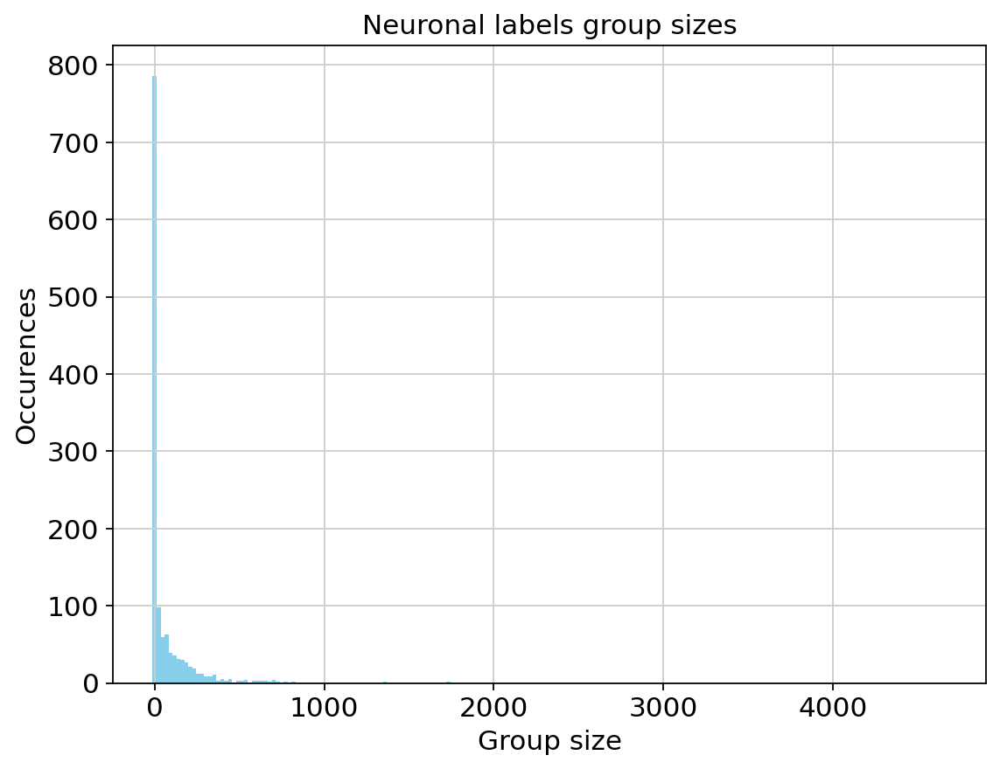

In [54]:
from collections import Counter
data= b.obs['cell_type_high_res'].value_counts().tolist()
counter = Counter(data)
values = list(counter.keys())
frequencies = list(counter.values())

num_bins = 200
hist, bins = np.histogram(data, bins=num_bins)


plt.figure(figsize=(8, 6))
plt.bar(bins[:-1], hist, width=np.diff(bins), color='skyblue')  # Plotting the histogram as a bar plot

plt.xlabel('Group size')
plt.ylabel('Occurences')
plt.title('Neuronal labels group sizes')

plt.show()

In [185]:
set(b.obs['siletti_dissection_abrev'].tolist())

{'', 'IC', 'PAG', 'PAG-DR', 'PTR', 'RN', 'SC', 'SN', 'SN-RN'}

In [64]:
color_map = {'SN':(0.2980392156862745, 0.4470588235294118, 0.6901960784313725),
'PAG':(0.8666666666666667, 0.5176470588235295, 0.3215686274509804),
'SN-RN':(0.3333333333333333, 0.6588235294117647, 0.40784313725490196),
'PTR':(0.7686274509803922, 0.3058823529411765, 0.3215686274509804),
'RN':(0.5058823529411764, 0.4470588235294118, 0.7019607843137254),
'SC':(0.5764705882352941, 0.47058823529411764, 0.3764705882352941),
'IC':(0.8549019607843137, 0.5450980392156862, 0.7647058823529411),
'':(0.5490196078431373, 0.5490196078431373, 0.5490196078431373),
'PAG-DR':(0.8, 0.7254901960784313, 0.4549019607843137)}

only one siletti subtype

In [65]:
subtype='650-siletti'

df=b[b.obs['cell_type_high_res']==subtype].obs['siletti_dissection_abrev'].value_counts()
keys=df.keys().tolist()
values=df.tolist()
percentages=[v*100/sum(values) for v in values]

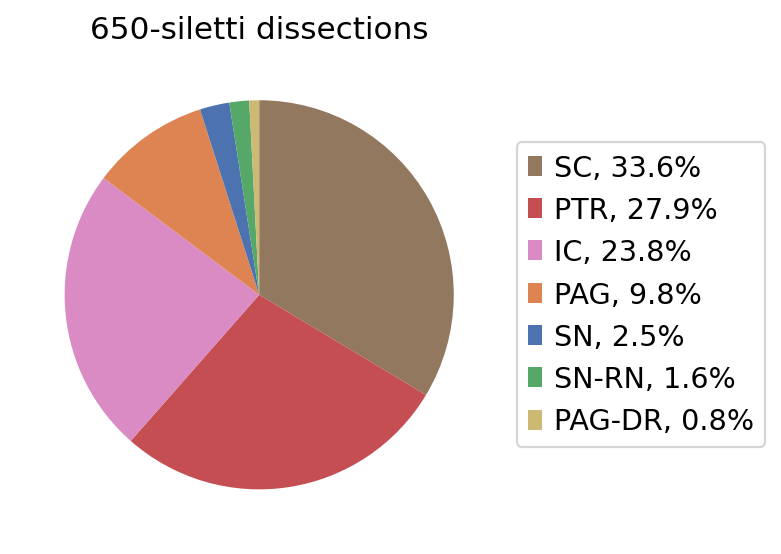

In [66]:

colors = [color_map.get(key) for key in keys]
plt.pie(values,  colors = colors,startangle=90,counterclock=False)
plt.title(f'{subtype} dissections')
labels = [f'{l}, {s:0.1f}%' for l, s in zip(keys, percentages)]
plt.legend(labels, loc='center left', bbox_to_anchor=(1, 0.5))
plt.savefig(f'/home/hers_basak/jjiang/jack/outputs/deliverables/6_analysis/s{subtype}_dissect.png', bbox_inches='tight')
plt.show()

for multiple values

In [67]:

more=['1346-siletti', '1347-siletti']

df=b[b.obs['cell_type_high_res'].isin(more)].obs['siletti_dissection_abrev'].value_counts()
keys=df.keys().tolist()
values=df.tolist()
percentages=[v*100/sum(values) for v in values]

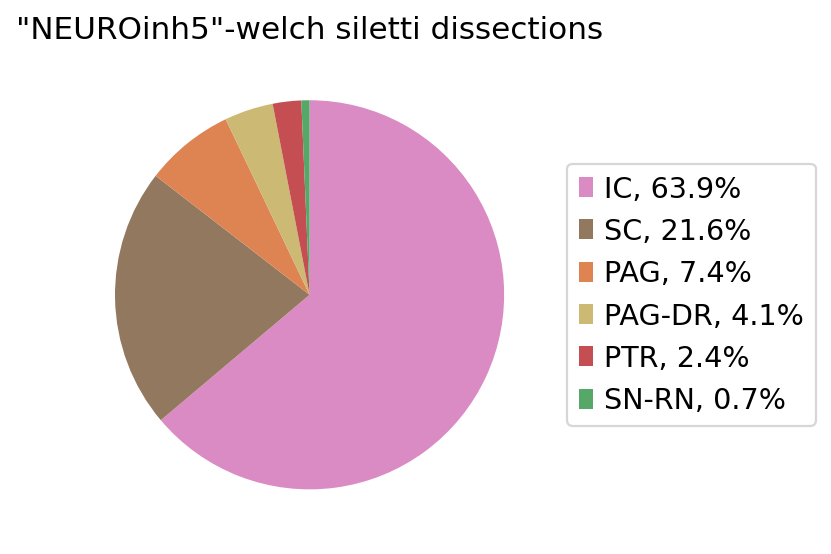

In [68]:
subtype='"NEUROinh5"-welch'
colors = [color_map.get(key) for key in keys]
plt.pie(values,  colors = colors,startangle=90,counterclock=False)
plt.title(f'{subtype} siletti dissections')
labels = [f'{l}, {s:0.1f}%' for l, s in zip(keys, percentages)]
plt.legend(labels, loc='center left', bbox_to_anchor=(1, 0.5))
plt.savefig(f'/home/hers_basak/jjiang/jack/outputs/deliverables/6_analysis/{subtype}_siletti_dissect.png', bbox_inches='tight')
plt.show()

In [40]:
for i in ['Neuron-GABA-3-altena',
 'Neuron-GABA-4-altena',
 '"NEUROex1"-welch',
 'Inhibitory-smajic',
 'DaNs-agarwal']:
    print(b[b.obs['cell_type_high_res'] == i])

View of AnnData object with n_obs × n_vars = 45 × 5000
    obs: 'species', 'gender', 'age', 'instrument', 'technology', 'atlas', 'sample', 'batch_1', 'doublet_score', 'predicted_doublet', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'total_counts_mt', 'log1p_total_counts_mt', 'pct_counts_mt', 'total_counts_ribo', 'log1p_total_counts_ribo', 'pct_counts_ribo', 'n_genes', 'total_counts_mito', 'total_counts_norm', 'original_Library', 'original_Brain_Region', 'original_Level_1_cell_type', 'original_Level_2_cell_type', 'original_cellclass_lvl1', 'original_subclass_lvl3_1', 'original_cellclass_lvl1_n', 'original_lineage', 'original_subclass_lvl2', 'original_celltype_lvl3', 'donor', 'original_supercluster_term', 'original_cluster_id', 'original_subcluster_id', 'original_celltype', 'cell_type_lvl1', 'cell_type_lvl2', 'cell_type_lvl3', 'harmonized_lowest_filtered_02_scvi', 'cell_type_lowest_res', 'cell_type_low_res', 'cell_type_med_res', 'cell_type_high_r

In [24]:
a[a.obs['cell_type_high_res']=='Neuron-GABA-DOPA-3-altena'].obs['cell_type_low_res']

GCCCGAATCACCTCGT-1-3    Neuron-altena
ATCGGCGCACTATCCC-1-3    Neuron-altena
TATTGGGGTATACGGG-1-3    Neuron-altena
CTCAGGGGTCATAAAG-1-3    Neuron-altena
CATGAGTCACGACGTC-1-3    Neuron-altena
                            ...      
TTGGGTACATTAAAGG-1-4    Neuron-altena
AGCTACAAGGTCACTT-1-4    Neuron-altena
GCCGTGATCCTCAGAA-1-4    Neuron-altena
CGAGAAGGTCTGCCTT-1-5    Neuron-altena
TATACCTTCCAGTACA-1-5    Neuron-altena
Name: cell_type_low_res, Length: 99, dtype: category
Categories (1, object): ['Neuron-altena']

In [7]:
a.obs['atlas'].value_counts()

atlas
siletti    123441
smajic       2844
altena       1476
welch        1131
agarwal       211
Name: count, dtype: int64

In [72]:
a

AnnData object with n_obs × n_vars = 157244 × 2000
    obs: 'species', 'gender', 'age', 'instrument', 'technology', 'atlas', 'sample', 'batch_1', 'doublet_score', 'predicted_doublet', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'total_counts_mt', 'log1p_total_counts_mt', 'pct_counts_mt', 'total_counts_ribo', 'log1p_total_counts_ribo', 'pct_counts_ribo', 'n_genes', 'total_counts_mito', 'total_counts_norm', 'original_Library', 'original_Brain_Region', 'original_Level_1_cell_type', 'original_Level_2_cell_type', 'original_cellclass_lvl1', 'original_subclass_lvl3_1', 'original_cellclass_lvl1_n', 'original_lineage', 'original_subclass_lvl2', 'original_celltype_lvl3', 'donor', 'original_supercluster_term', 'original_cluster_id', 'original_subcluster_id', 'original_celltype', 'cell_type_lvl1', 'cell_type_lvl2', 'cell_type_lvl3', '_scvi_batch', '_scvi_labels', 'leiden', 'cell_type_low_res', 'cell_type_high_res', 'harmonized_cell_type', 'harmonized_lowes

In [5]:
sc.pp.neighbors(b, n_pcs=90,n_neighbors=50,use_rep='X_scVI')



/home/hers_basak/jjiang/jack/miniconda/envs/scarches2/lib/python3.9/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


In [6]:
sc.tl.umap(b
           #,n_components=3
          )

want to keep original colors of altases

In [7]:
color_map = {
    'siletti':'#2ca02c',
    'welch':'#8c564b',
    'smajic':'#d62728',
    'altena':'#ff7f0e',
    'agarwal':'#1f77b4'
}

make sure the smaller atlases get plotted later

In [8]:
unique_values_sorted=['siletti','welch','smajic','altena','agarwal']
custom_order = []
for value in unique_values_sorted:
    indices = b.obs[b.obs['atlas'] == value].index
    custom_order.extend(indices)
adata = b[custom_order, :]

In [130]:
custom_order

['10X173_3:AAAGGGCCATGCCGCA',
 '10X173_3:TCTATCATCCCGTTCA',
 '10X173_3:GTCTCACTCGCCAACG',
 '10X173_3:TATACCTTCACTCCGT',
 '10X173_3:TATCTTGTCACCTTAT',
 '10X173_3:ATCTTCAGTATACCCA',
 '10X173_3:GGTCACGTCCTACACC',
 '10X173_3:TTTCGATTCGCATTGA',
 '10X173_3:GTTAGTGAGCCGGAAT',
 '10X173_3:GACTTCCCAATTCACG',
 '10X173_3:ATGAAAGTCTCTGACC',
 '10X173_3:CAATTTCGTCGTTCAA',
 '10X173_3:TTGCCTGAGACTACCT',
 '10X173_3:AATCACGCAGGTCCGT',
 '10X173_3:GGGCCATAGGGTGAGG',
 '10X173_3:AGGGCCTGTTCTTGCC',
 '10X173_3:CTACCTGCACTTCTCG',
 '10X173_3:AACCTTTAGCTCCATA',
 '10X173_3:ATTCCCGGTACCCGCA',
 '10X173_3:ATCGCCTAGGGTAATT',
 '10X173_3:CTCCCTCCACAAATCC',
 '10X173_3:TCTTCCTTCCGCGAGT',
 '10X173_3:CGGAATTCACCTTCCA',
 '10X173_3:CATTCCGAGTTGCCTA',
 '10X173_3:AGTCACACAAATAAGC',
 '10X173_3:TCTAACTGTATGATCC',
 '10X173_3:CCGGACAAGGCCTGCT',
 '10X173_3:GTCTACCTCATTTGGG',
 '10X173_3:GGACGTCAGACGCTCC',
 '10X173_3:AGTGACTAGACAACTA',
 '10X173_3:GCTTCACGTGGCATCC',
 '10X173_3:ATGGATCAGACGCATG',
 '10X173_3:TTCATGTTCCTCGATC',
 '10X173_3

In [131]:
adata = b[custom_order, :]

/home/hers_basak/jjiang/jack/miniconda/envs/scarches2/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:1207: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if not is_categorical_dtype(values):
/home/hers_basak/jjiang/jack/miniconda/envs/scarches2/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:1216: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/home/hers_basak/jjiang/jack/miniconda/envs/scarches2/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:391: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


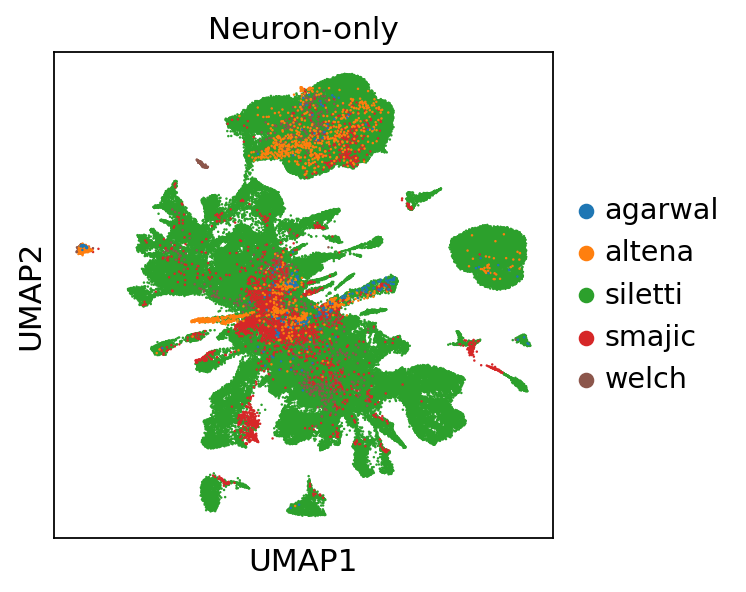

In [134]:

sc.pl.umap(adata, color='atlas', use_raw=False, s=5,show=True, title='Neuron-only',save='_atlas_neuron_known.png',palette=color_map)

/home/hers_basak/jjiang/jack/miniconda/envs/scarches2/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:1169: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if groups and is_categorical_dtype(values):
/home/hers_basak/jjiang/jack/miniconda/envs/scarches2/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:1207: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if not is_categorical_dtype(values):
/home/hers_basak/jjiang/jack/miniconda/envs/scarches2/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:1216: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd

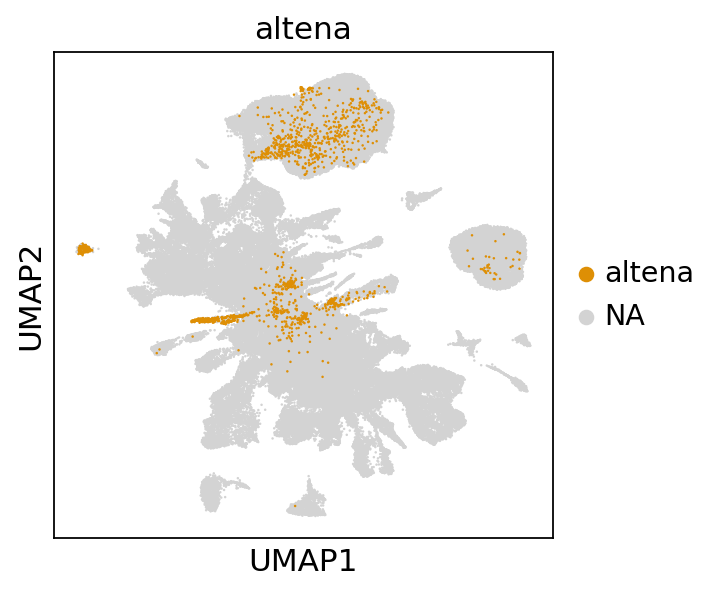

In [133]:

sc.pl.umap(b, color='atlas',title='altena', groups= ['altena'], use_raw=False, s=5, show=True,palette=sns.color_palette('colorblind', as_cmap=True))

/home/hers_basak/jjiang/jack/miniconda/envs/scarches2/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:1169: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if groups and is_categorical_dtype(values):
/home/hers_basak/jjiang/jack/miniconda/envs/scarches2/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:1207: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if not is_categorical_dtype(values):
/home/hers_basak/jjiang/jack/miniconda/envs/scarches2/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:1216: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd

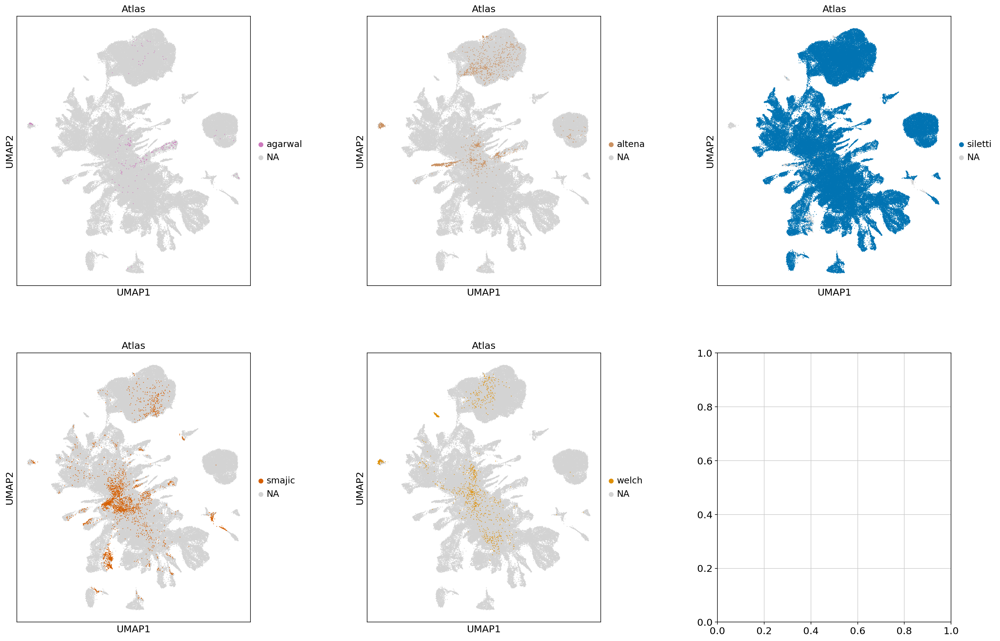

In [16]:
feature1='atlas'
title1='Atlas'

fig, axs = plt.subplots(2, 3, figsize = [24,16])
#axs[-1, -1].axis('off')
fig.subplots_adjust(left=None, bottom=None, right=None, top=None, wspace=0.5, hspace=0.25)
sc.pl.umap(a, color=feature1, groups= 'agarwal', use_raw=False, s=5, ax= axs[0,0],show=False, title=title1,palette=sns.color_palette('colorblind', as_cmap=True))
sc.pl.umap(a, color=feature1, groups= 'altena', use_raw=False, s=5, ax= axs[0,1],show=False, title=title1,palette=sns.color_palette('colorblind', as_cmap=True))
sc.pl.umap(a, color=feature1, groups= 'siletti', use_raw=False, s=5, ax= axs[0,2],show=False, title=title1,palette=sns.color_palette('colorblind', as_cmap=True))
sc.pl.umap(a, color=feature1, groups= 'smajic', use_raw=False, s=5, ax= axs[1,0],show=False, title=title1,palette=sns.color_palette('colorblind', as_cmap=True))
sc.pl.umap(a, color=feature1, groups= 'welch', use_raw=False, s=5, ax= axs[1,1],show=False, title=title1,palette=sns.color_palette('colorblind', as_cmap=True))
fig.savefig(f'umap_neuron_atlas_known_subplots.png',bbox_inches='tight')

The color sets are rotating based on all values within a label so that's why we see duplicate colors in umap... I couldn't really fix this at the end

/home/hers_basak/jjiang/jack/miniconda/envs/scarches2/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:1169: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if groups and is_categorical_dtype(values):
/home/hers_basak/jjiang/jack/miniconda/envs/scarches2/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:1207: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if not is_categorical_dtype(values):
/home/hers_basak/jjiang/jack/miniconda/envs/scarches2/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:1216: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd

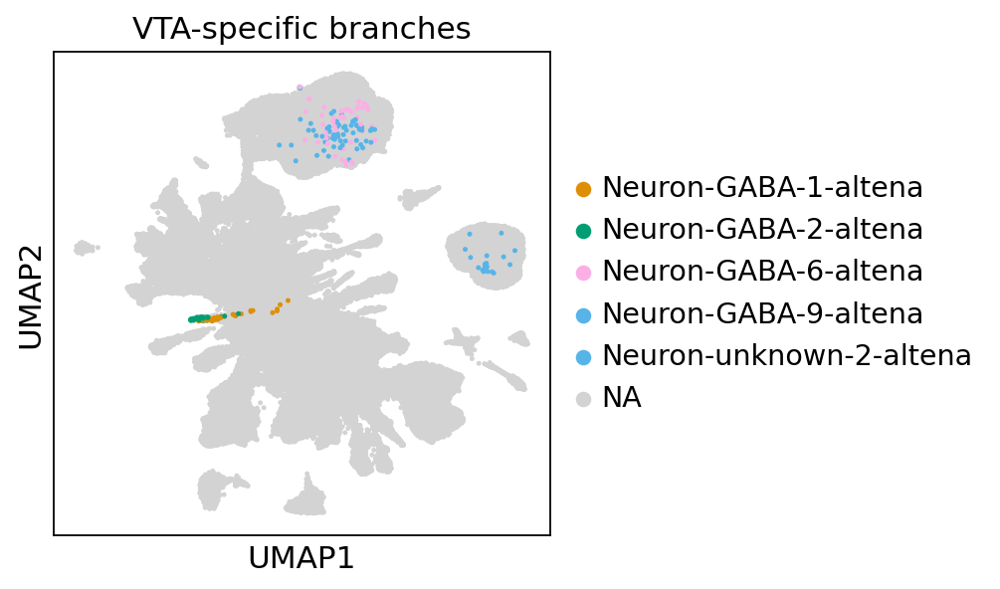

In [60]:
feature1='cell_type_high_res'
sc.pl.umap(b, color=feature1,title='VTA-specific branches', groups= ['Neuron-unknown-2-altena','Neuron-GABA-1-altena','Neuron-GABA-2-altena','Neuron-GABA-6-altena','Neuron-GABA-9-altena'], use_raw=False, s=20, show=True,palette=sns.color_palette('colorblind'),save='_unique_altena')

/home/hers_basak/jjiang/jack/miniconda/envs/scarches2/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:1169: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if groups and is_categorical_dtype(values):
/home/hers_basak/jjiang/jack/miniconda/envs/scarches2/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:1207: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if not is_categorical_dtype(values):
/home/hers_basak/jjiang/jack/miniconda/envs/scarches2/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:1216: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd

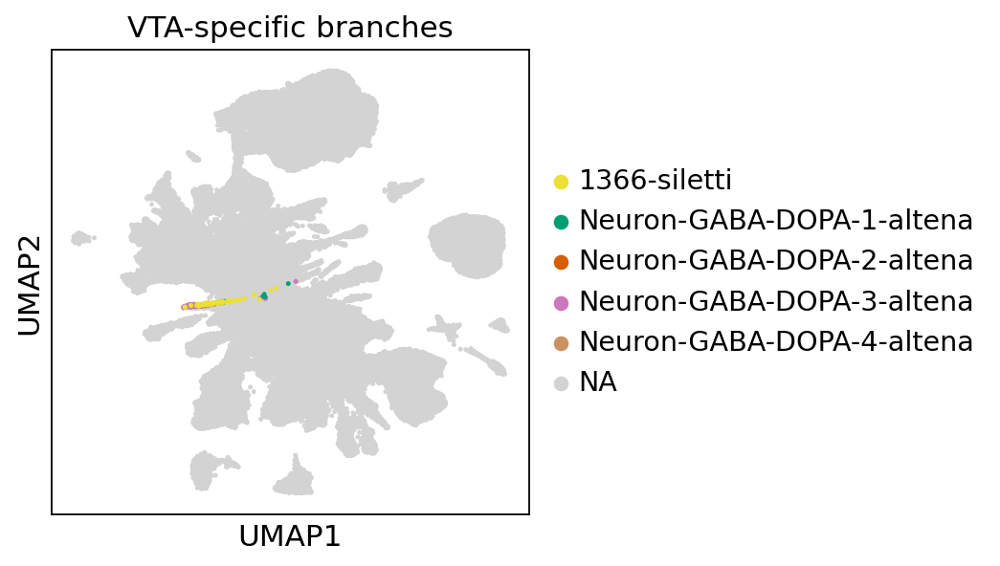

In [62]:
feature1='cell_type_high_res'
sc.pl.umap(b, color=feature1,title='VTA-specific branches', groups= ['1366-siletti','Neuron-GABA-DOPA-1-altena','Neuron-GABA-DOPA-2-altena','Neuron-GABA-DOPA-3-altena','Neuron-GABA-DOPA-4-altena'], use_raw=False, s=20, show=True,palette=sns.color_palette('colorblind', as_cmap=True))

/home/hers_basak/jjiang/jack/miniconda/envs/scarches2/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:1169: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if groups and is_categorical_dtype(values):
/home/hers_basak/jjiang/jack/miniconda/envs/scarches2/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:1207: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if not is_categorical_dtype(values):
/home/hers_basak/jjiang/jack/miniconda/envs/scarches2/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:1216: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd

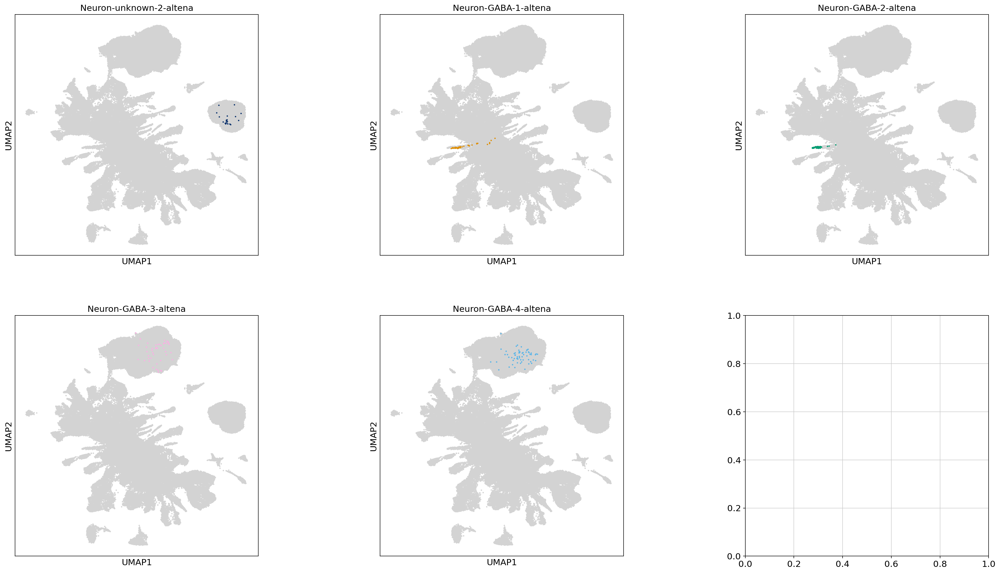

In [58]:
feature1='cell_type_high_res'
title1='1366-Siletti and Neuron-GABA-DOPA-N-Altena'

fig, axs = plt.subplots(2, 3, figsize = [28,16])
#axs[-1, -1].axis('off')
fig.subplots_adjust(left=None, bottom=None, right=None, top=None, wspace=0.5, hspace=0.25)
sc.pl.umap(b, color=feature1, groups= 'Neuron-unknown-2-altena', use_raw=False, s=20, ax= axs[0,0],show=False, title='Neuron-unknown-2-altena',legend_loc='none',palette='Blues')
sc.pl.umap(b, color=feature1, groups= 'Neuron-GABA-1-altena', use_raw=False, s=20, ax= axs[0,1],show=False, title='Neuron-GABA-1-altena',legend_loc='none',palette=sns.color_palette('colorblind', as_cmap=True))
sc.pl.umap(b, color=feature1, groups= 'Neuron-GABA-2-altena', use_raw=False, s=20, ax= axs[0,2],show=False, title='Neuron-GABA-2-altena',legend_loc='none',palette=sns.color_palette('colorblind', as_cmap=True))
sc.pl.umap(b, color=feature1, groups= 'Neuron-GABA-6-altena', use_raw=False, s=20, ax= axs[1,0],show=False, title='Neuron-GABA-3-altena',legend_loc='none',palette=sns.color_palette('colorblind', as_cmap=True))
sc.pl.umap(b, color=feature1, groups= 'Neuron-GABA-9-altena', use_raw=False, s=20, ax= axs[1,1],show=False, title='Neuron-GABA-4-altena',legend_loc='none',palette=sns.color_palette('colorblind', as_cmap=True))
fig.savefig(f'/home/hers_basak/jjiang/jack/outputs/deliverables/6_analysis/umap_neuron_unique.png',bbox_inches='tight')

## Oligo
Oligodendrocyte only integration looks odd, not sure if there is this little variation or unclear variation. Hyperparameters that work for complex datasets such as that of the neuron might not work well with Oligodendrocyte subset, should integrate again with Harmony.

In [11]:
oligo=sc.read_h5ad('/home/hers_basak/jjiang/jack/outputs/deliverables/5_integration/data/scvi/models/scvi_model_final_oligo_all/adata_5k_known.h5ad')

In [9]:
sc.pp.highly_variable_genes(
   a,
    n_top_genes=2000,
    batch_key="atlas",
    subset=True)

/home/hers_basak/jjiang/jack/miniconda/envs/scarches2/lib/python3.9/site-packages/scanpy/preprocessing/_highly_variable_genes.py:215: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  disp_grouped = df.groupby('mean_bin')['dispersions']
/home/hers_basak/jjiang/jack/miniconda/envs/scarches2/lib/python3.9/site-packages/scanpy/preprocessing/_highly_variable_genes.py:215: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  disp_grouped = df.groupby('mean_bin')['dispersions']
/home/hers_basak/jjiang/jack/miniconda/envs/scarches2/lib/python3.9/site-packages/scanpy/preprocessing/_highly_variable_genes.py:215: FutureWarning: T

In [149]:
oligo.obs['cell_type_low_res'].value_counts()

cell_type_low_res
Oligodendrocyte-siletti                        79386
Oligodendrocyte-altena                         55702
Unknown-wang                                   24003
Unknown-welch                                  21652
Oligodendrocytes-smajic                        12613
Unknown-siletti                                11365
Unknown-smajic                                  4926
ODC-agarwal                                     3978
"OLIGO1"-welch                                  3451
"OLIGO3"-welch                                  2916
"OLIGO4"-welch                                  2888
"OLIGO2"-welch                                  2840
Unknown-agarwal                                 2242
"OLIGO5"-welch                                  1381
Unknown-altena                                   788
"NEUROinh3"-welch                                112
Committed oligodendrocyte precursor-siletti       70
Microglia-agarwal                                 30
"NEUROinh1"-welch           

In [39]:
#sc.tl.pca(oligo, svd_solver='arpack')
sc.pp.neighbors(oligo, n_pcs=90,n_neighbors=50,use_rep='X_scVI')

sc.tl.umap(oligo)

In [40]:
oligo

AnnData object with n_obs × n_vars = 165413 × 5000
    obs: 'species', 'gender', 'age', 'instrument', 'technology', 'atlas', 'sample', 'batch_1', 'doublet_score', 'predicted_doublet', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'total_counts_mt', 'log1p_total_counts_mt', 'pct_counts_mt', 'total_counts_ribo', 'log1p_total_counts_ribo', 'pct_counts_ribo', 'n_genes', 'total_counts_mito', 'total_counts_norm', 'original_Library', 'original_Brain_Region', 'original_Level_1_cell_type', 'original_Level_2_cell_type', 'original_cellclass_lvl1', 'original_subclass_lvl3_1', 'original_cellclass_lvl1_n', 'original_lineage', 'original_subclass_lvl2', 'original_celltype_lvl3', 'donor', 'original_supercluster_term', 'original_cluster_id', 'original_subcluster_id', 'original_celltype', 'cell_type_lvl1', 'cell_type_lvl2', 'cell_type_lvl3', 'harmonized_lowest_filtered_02_scvi', 'cell_type_lowest_res', 'cell_type_low_res', 'cell_type_med_res', 'cell_type_high_res'


/home/hers_basak/jjiang/jack/miniconda/envs/scarches2/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:1207: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if not is_categorical_dtype(values):
/home/hers_basak/jjiang/jack/miniconda/envs/scarches2/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:1216: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/home/hers_basak/jjiang/jack/miniconda/envs/scarches2/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:391: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


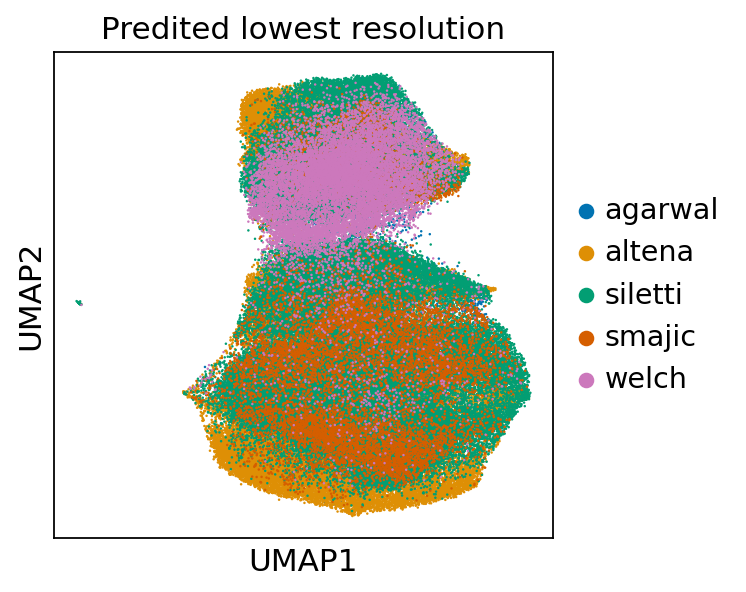

In [41]:
sc.pl.umap(oligo, color=['atlas'], title='Predited lowest resolution',
               use_raw=False, s=5, wspace=0.5,save='_atlas_oligo_known_n50.png')

/home/hers_basak/jjiang/jack/miniconda/envs/scarches2/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:1169: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if groups and is_categorical_dtype(values):
/home/hers_basak/jjiang/jack/miniconda/envs/scarches2/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:1207: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if not is_categorical_dtype(values):
/home/hers_basak/jjiang/jack/miniconda/envs/scarches2/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:1216: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd

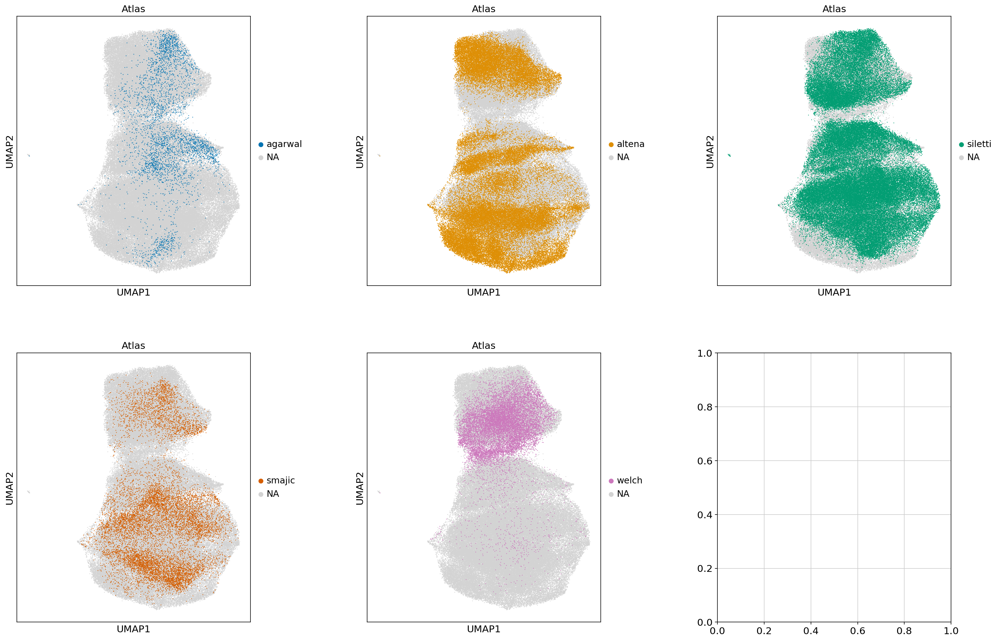

In [42]:
feature1='atlas'
title1='Atlas'

fig, axs = plt.subplots(2, 3, figsize = [24,16])
#axs[-1, -1].axis('off')
fig.subplots_adjust(left=None, bottom=None, right=None, top=None, wspace=0.5, hspace=0.25)
sc.pl.umap(oligo, color=feature1, groups= 'agarwal', use_raw=False, s=5, ax= axs[0,0],show=False, title=title1,palette=sns.color_palette('colorblind', as_cmap=True))
sc.pl.umap(oligo, color=feature1, groups= 'altena', use_raw=False, s=5, ax= axs[0,1],show=False, title=title1,palette=sns.color_palette('colorblind', as_cmap=True))
sc.pl.umap(oligo, color=feature1, groups= 'siletti', use_raw=False, s=5, ax= axs[0,2],show=False, title=title1,palette=sns.color_palette('colorblind', as_cmap=True))
sc.pl.umap(oligo, color=feature1, groups= 'smajic', use_raw=False, s=5, ax= axs[1,0],show=False, title=title1,palette=sns.color_palette('colorblind', as_cmap=True))
sc.pl.umap(oligo, color=feature1, groups= 'welch', use_raw=False, s=5, ax= axs[1,1],show=False, title=title1,palette=sns.color_palette('colorblind', as_cmap=True))
fig.savefig(f'umap_oligo_atlas_known_subplots_n50.png',bbox_inches='tight')

## Astro
Astrocyte only integration looks very odd, hyperparameters that work for complex datasets such as that of the neuron might not work well with Astrocytes subset, should integrate again with Harmony.

In [6]:
astro=sc.read_h5ad('/home/hers_basak/jjiang/jack/outputs/deliverables/5_integration/data/scvi/models/scvi_model_final_astro_all/adata_5k.h5ad')

In [7]:
astro

AnnData object with n_obs × n_vars = 39179 × 5000
    obs: 'species', 'gender', 'age', 'instrument', 'technology', 'atlas', 'sample', 'batch_1', 'doublet_score', 'predicted_doublet', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'total_counts_mt', 'log1p_total_counts_mt', 'pct_counts_mt', 'total_counts_ribo', 'log1p_total_counts_ribo', 'pct_counts_ribo', 'n_genes', 'total_counts_mito', 'total_counts_norm', 'original_Library', 'original_Brain_Region', 'original_Level_1_cell_type', 'original_Level_2_cell_type', 'original_cellclass_lvl1', 'original_subclass_lvl3_1', 'original_cellclass_lvl1_n', 'original_lineage', 'original_subclass_lvl2', 'original_celltype_lvl3', 'donor', 'original_supercluster_term', 'original_cluster_id', 'original_subcluster_id', 'original_celltype', 'cell_type_lvl1', 'cell_type_lvl2', 'cell_type_lvl3', 'harmonized_lowest_filtered_02_scvi', 'cell_type_lowest_res', 'cell_type_low_res', 'cell_type_med_res', 'cell_type_high_res'
 

In [34]:
astro.obs['cell_type_low_res'].value_counts()

cell_type_low_res
Astrocyte-siletti           13203
Astrocyte-altena             8624
Unknown-welch                6913
Unknown-siletti              2746
Unknown-wang                 2588
Astrocytes-smajic            2083
"ASTRO"-welch                 738
Unknown-smajic                608
"ASTROgfap"-welch             489
"ASTROfos"-welch              466
Astrocytes-agarwal            234
Unknown-agarwal               210
Unknown-altena                206
Bergmann glia-siletti          29
Ependymal-smajic               22
Endothelial-agarwal             8
ODC-agarwal                     7
Microglia-agarwal               3
Endothelial cells-smajic        1
Oligodendrocyte-altena          1
Name: count, dtype: int64

In [ ]:
#sc.tl.pca(oligo, svd_solver='arpack')
sc.pp.neighbors(astro, n_pcs=90,n_neighbors=30,use_rep='X_scVI')

sc.tl.umap(astro)

In [37]:
astro

AnnData object with n_obs × n_vars = 39179 × 5000
    obs: 'species', 'gender', 'age', 'instrument', 'technology', 'atlas', 'sample', 'batch_1', 'doublet_score', 'predicted_doublet', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'total_counts_mt', 'log1p_total_counts_mt', 'pct_counts_mt', 'total_counts_ribo', 'log1p_total_counts_ribo', 'pct_counts_ribo', 'n_genes', 'total_counts_mito', 'total_counts_norm', 'original_Library', 'original_Brain_Region', 'original_Level_1_cell_type', 'original_Level_2_cell_type', 'original_cellclass_lvl1', 'original_subclass_lvl3_1', 'original_cellclass_lvl1_n', 'original_lineage', 'original_subclass_lvl2', 'original_celltype_lvl3', 'donor', 'original_supercluster_term', 'original_cluster_id', 'original_subcluster_id', 'original_celltype', 'cell_type_lvl1', 'cell_type_lvl2', 'cell_type_lvl3', 'harmonized_lowest_filtered_02_scvi', 'cell_type_lowest_res', 'cell_type_low_res', 'cell_type_med_res', 'cell_type_high_res'
 

/home/hers_basak/jjiang/jack/miniconda/envs/scarches2/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:1207: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if not is_categorical_dtype(values):
/home/hers_basak/jjiang/jack/miniconda/envs/scarches2/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:1216: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/home/hers_basak/jjiang/jack/miniconda/envs/scarches2/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:391: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


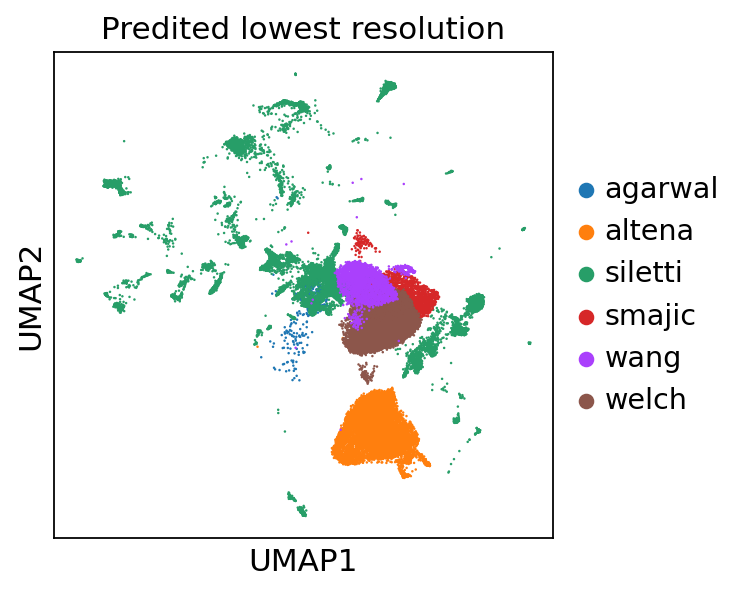

In [36]:
sc.pl.umap(astro, color=['atlas'], title='Predited lowest resolution',
               use_raw=False, s=5, wspace=0.5,save='_atlas_astro_n30.png')

/home/hers_basak/jjiang/jack/miniconda/envs/scarches2/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:1207: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if not is_categorical_dtype(values):
/home/hers_basak/jjiang/jack/miniconda/envs/scarches2/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:1216: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/home/hers_basak/jjiang/jack/miniconda/envs/scarches2/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:391: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


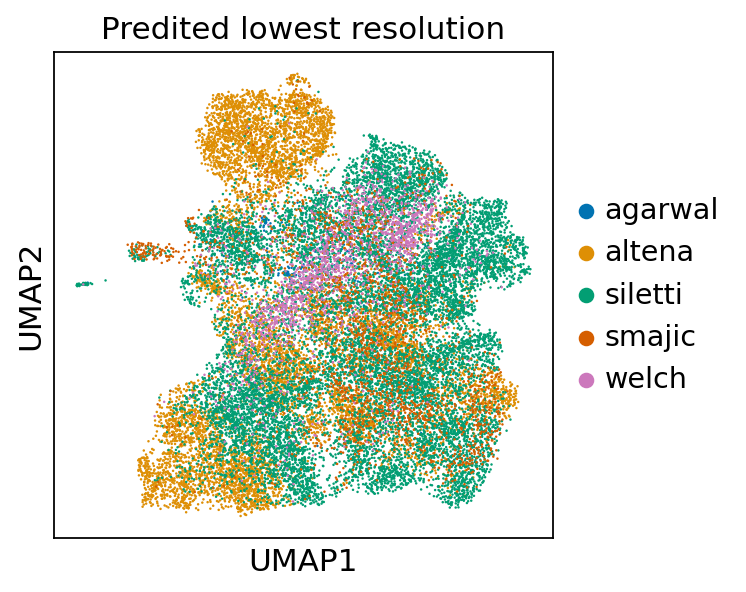

In [31]:
sc.pl.umap(astro, color=['atlas'], title='Predited lowest resolution',
               use_raw=False, s=5, wspace=0.5,save='_atlas_astro_known_n30.png')

/home/hers_basak/jjiang/jack/miniconda/envs/scarches2/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:1169: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if groups and is_categorical_dtype(values):
/home/hers_basak/jjiang/jack/miniconda/envs/scarches2/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:1207: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if not is_categorical_dtype(values):
/home/hers_basak/jjiang/jack/miniconda/envs/scarches2/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:1216: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd

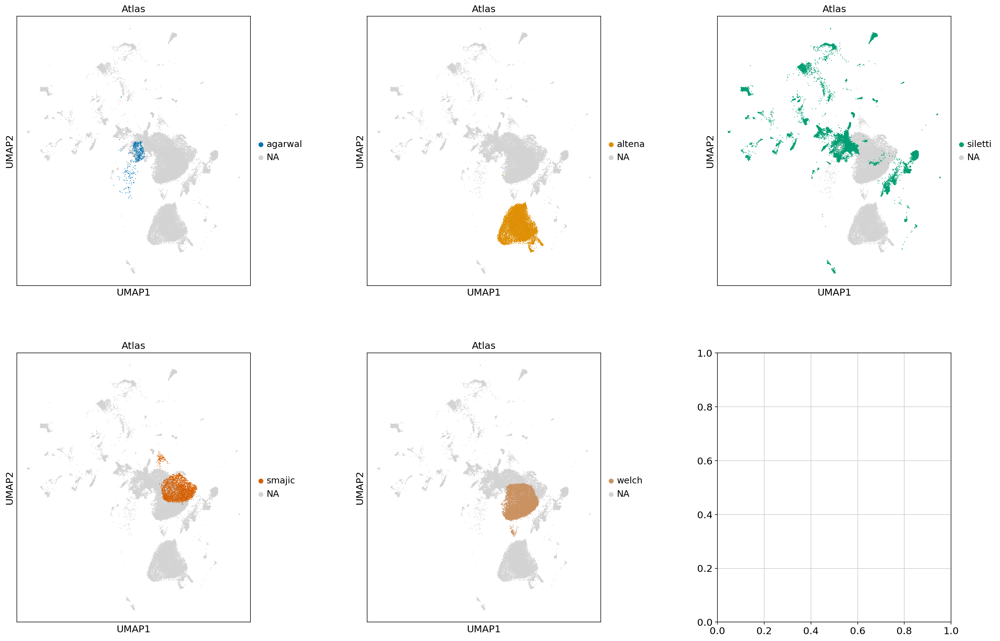

In [38]:
feature1='atlas'
title1='Atlas'

fig, axs = plt.subplots(2, 3, figsize = [24,16])
#axs[-1, -1].axis('off')
fig.subplots_adjust(left=None, bottom=None, right=None, top=None, wspace=0.5, hspace=0.25)
sc.pl.umap(astro, color=feature1, groups= 'agarwal', use_raw=False, s=5, ax= axs[0,0],show=False, title=title1,palette=sns.color_palette('colorblind', as_cmap=True))
sc.pl.umap(astro, color=feature1, groups= 'altena', use_raw=False, s=5, ax= axs[0,1],show=False, title=title1,palette=sns.color_palette('colorblind', as_cmap=True))
sc.pl.umap(astro, color=feature1, groups= 'siletti', use_raw=False, s=5, ax= axs[0,2],show=False, title=title1,palette=sns.color_palette('colorblind', as_cmap=True))
sc.pl.umap(astro, color=feature1, groups= 'smajic', use_raw=False, s=5, ax= axs[1,0],show=False, title=title1,palette=sns.color_palette('colorblind', as_cmap=True))
sc.pl.umap(astro, color=feature1, groups= 'welch', use_raw=False, s=5, ax= axs[1,1],show=False, title=title1,palette=sns.color_palette('colorblind', as_cmap=True))
fig.savefig(f'umap_astro_atlas_subplots_n30.png',bbox_inches='tight')

/home/hers_basak/jjiang/jack/miniconda/envs/scarches2/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:1169: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if groups and is_categorical_dtype(values):
/home/hers_basak/jjiang/jack/miniconda/envs/scarches2/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:1207: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if not is_categorical_dtype(values):
/home/hers_basak/jjiang/jack/miniconda/envs/scarches2/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:1216: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd

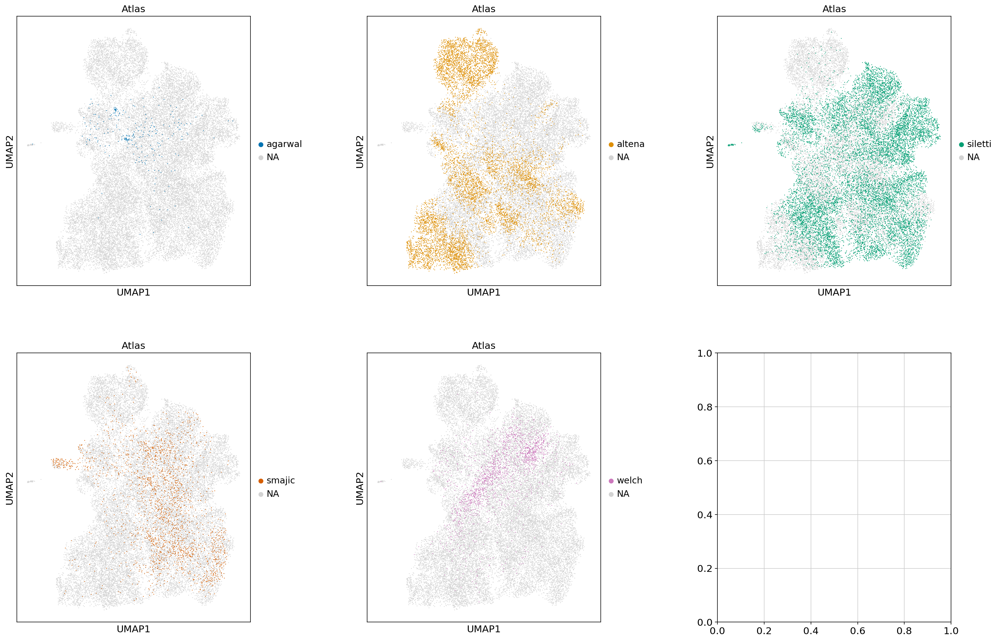

In [32]:
feature1='atlas'
title1='Atlas'

fig, axs = plt.subplots(2, 3, figsize = [24,16])
#axs[-1, -1].axis('off')
fig.subplots_adjust(left=None, bottom=None, right=None, top=None, wspace=0.5, hspace=0.25)
sc.pl.umap(astro, color=feature1, groups= 'agarwal', use_raw=False, s=5, ax= axs[0,0],show=False, title=title1,palette=sns.color_palette('colorblind', as_cmap=True))
sc.pl.umap(astro, color=feature1, groups= 'altena', use_raw=False, s=5, ax= axs[0,1],show=False, title=title1,palette=sns.color_palette('colorblind', as_cmap=True))
sc.pl.umap(astro, color=feature1, groups= 'siletti', use_raw=False, s=5, ax= axs[0,2],show=False, title=title1,palette=sns.color_palette('colorblind', as_cmap=True))
sc.pl.umap(astro, color=feature1, groups= 'smajic', use_raw=False, s=5, ax= axs[1,0],show=False, title=title1,palette=sns.color_palette('colorblind', as_cmap=True))
sc.pl.umap(astro, color=feature1, groups= 'welch', use_raw=False, s=5, ax= axs[1,1],show=False, title=title1,palette=sns.color_palette('colorblind', as_cmap=True))
fig.savefig(f'umap_astro_atlas_known_subplots_n30.png',bbox_inches='tight')